# Figure 5: Cellular Neighborhoods

In [10]:
import pandas as pd
import sys

In [11]:
sys.path.append('/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python') # This code is only needed if you want to load functions from a non-default directory

from SAP_helperfunctions_hf import * # Helper functions - used by other functions to execute steps like table formatting etc. KEY: hf
from SAP_preprocessing_pp import * # Preprocessing functions - to normalize and prepare data for further analysis KEY: pp
from SAP_tools_tl import * # tools - perform calculation on the data KEY: tl
from SAP_plot_pl import * # plotting functions - used to visualize results KEY: pl

## Load example data frame 

In [20]:
df = pd.read_csv("/Users/timnoahkempchen/Library/Mobile Documents/com~apple~CloudDocs/Uni/Master/Semester 3/Praktikum Nolan Lab/SAP_Paper_Pipeline_Presentation/Day135_Markers_Dryad.csv")
df.columns

/var/folders/6d/0x48qjh15rx9851lpdwvrxvc0000gn/T/ipykernel_27161/1010905885.py:1: DtypeWarning: Columns (64) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("/Users/timnoahkempchen/Library/Mobile Documents/com~apple~CloudDocs/Uni/Master/Semester 3/Praktikum Nolan Lab/SAP_Paper_Pipeline_Presentation/Day135_Markers_Dryad.csv")


Index(['Unnamed: 0', 'CD5', 'CD86', 'FOXP3', 'CD19', 'H2Db', 'TCF7', 'Ly6G',
       'PD1', 'TRYP1', 'NKp46', 'H2Kb', 'CD90', 'Tim3', 'PDL1', 'CD11b',
       'NKG2A', 'CD25', 'CD71', 'CD3', 'B220', 'CD11c', 'F480', 'Sca1', 'CD4',
       'Ly6C', 'CD27', 'Podoplanin', 'CD44', 'CD106', 'MHCII', '1632', 'TCRb',
       'CD69', 'Ki67', 'KLRG1', 'CD8', 'keratin8', 'CD169', 'CD31', 'CD45',
       'IgD', 'x', 'y', 'region_num', 'TCRgd', 'CD117', 'NK11', 'CD79b',
       'CD49b', 'IgM', 'Xcorr', 'Ycorr', 'array', 'original cell type',
       'Cell common', 'Neighborhood common', 'unique_region', 'day harvested',
       'replicate', 'date_array', 'CD62L', 'CCR7', 'ICOS',
       'original neighborhood'],
      dtype='object')

## Clustering into neighborhoods

### Parameters for neighborhood analysis

In [5]:
output_dir = "/Users/timnoahkempchen/Library/Mobile Documents/com~apple~CloudDocs/Uni/Master/Semester 3/Praktikum Nolan Lab/SAP_Paper_Pipeline_Presentation/Figures/Fig5"

In [29]:
# CN analysis
# Arguments for neighborhood analysis:
X = "x" # column containing the x coordinates 
Y = "y" # column containing the y coordinates 
reg = "unique_region" # column containg the unique regions 
cluster_col = "Cell common" # column which is used for clustering - typically cell types (to generate cellular neighborhoods)
output_dir = output_dir
k = 10
# set a single value to generate neighborhoods with this value. If you want to generate the elbow plot supply the list with a range of ks
#n_neighborhoods = numbers = list(range(1, 41))# number of generated neighborhoods - value should be biologically meaningful 

#n_neighborhoods = range(1,40)
save_to_csv= True

In [30]:
####### Neighborhood analysis 
df2 = pd.concat([df,pd.get_dummies(df[cluster_col])],1)
sum_cols = df2[cluster_col].unique()
values = df2[sum_cols].values

k_centroids = {}

/var/folders/6d/0x48qjh15rx9851lpdwvrxvc0000gn/T/ipykernel_27161/990583242.py:2: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  df2 = pd.concat([df,pd.get_dummies(df[cluster_col])],1)


## Clustering into communities 

Starting: 9/25 : 1_1_reg1
Finishing: 9/25 : 1_1_reg1 0.02455902099609375 0.02634906768798828
Starting: 22/25 : 1_1_reg39
Finishing: 22/25 : 1_1_reg39 0.03917407989501953 0.07282400131225586
Starting: 4/25 : 1_2
Finishing: 4/25 : 1_2 0.7026281356811523 0.7761762142181396
Starting: 5/25 : 1_3
Finishing: 5/25 : 1_3 0.011441946029663086 0.7955262660980225
Starting: 10/25 : 3_1_reg11
Finishing: 10/25 : 3_1_reg11 0.01700592041015625 0.8147890567779541
Starting: 16/25 : 3_1_reg28
Finishing: 16/25 : 3_1_reg28 0.03137373924255371 0.8471128940582275
Starting: 17/25 : 3_1_reg29
Finishing: 17/25 : 3_1_reg29 0.03508591651916504 0.8826489448547363
Starting: 23/25 : 3_1_reg46
Finishing: 23/25 : 3_1_reg46 0.01501607894897461 0.8980891704559326
Starting: 1/25 : 3_2
Finishing: 1/25 : 3_2 0.10330891609191895 1.0017399787902832
Starting: 2/25 : 3_3
Finishing: 2/25 : 3_3 0.2590188980102539 1.262138843536377
Starting: 3/25 : 3_4
Finishing: 3/25 : 3_4 0.07847929000854492 1.344041109085083
Starting: 11/25 : 5

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:125: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:127: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([cells[keep_cols],window],1)
/Users/timnoahkempchen/opt/anaconda3/envs/spatial_analysis_environment/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/timnoahkempchen/opt/anaconda3/envs/spatial_analysis_environment/lib/python3.10/site-packages/s

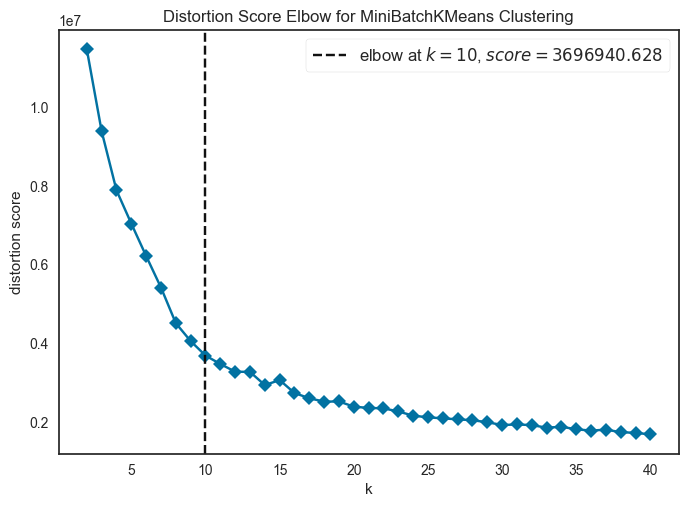

In [31]:
n_neighborhoods = 40 # test on 40 neighborhoods

cells_df, k_centroids = tl_neighborhood_analysis_2(data = df2, 
                           values = values, 
                           sum_cols = sum_cols, 
                           X = X, 
                           Y = Y, 
                           reg = reg, 
                           cluster_col = cluster_col, 
                           k = k, 
                           n_neighborhoods = n_neighborhoods,
                           elbow=True) 

Starting: 9/25 : 1_1_reg1
Finishing: 9/25 : 1_1_reg1 0.027140140533447266 0.028857946395874023
Starting: 22/25 : 1_1_reg39
Finishing: 22/25 : 1_1_reg39 0.03793001174926758 0.07186269760131836
Starting: 4/25 : 1_2
Finishing: 4/25 : 1_2 0.533289909362793 0.6061749458312988
Starting: 5/25 : 1_3
Finishing: 5/25 : 1_3 0.01123189926147461 0.6257781982421875
Starting: 10/25 : 3_1_reg11
Finishing: 10/25 : 3_1_reg11 0.016569852828979492 0.644697904586792
Starting: 16/25 : 3_1_reg28
Finishing: 16/25 : 3_1_reg28 0.030774831771850586 0.6764450073242188
Starting: 17/25 : 3_1_reg29
Finishing: 17/25 : 3_1_reg29 0.034915924072265625 0.7118899822235107
Starting: 23/25 : 3_1_reg46
Finishing: 23/25 : 3_1_reg46 0.015060901641845703 0.727374792098999
Starting: 1/25 : 3_2
Finishing: 1/25 : 3_2 0.11237502098083496 0.8402881622314453
Starting: 2/25 : 3_3
Finishing: 2/25 : 3_3 0.2554280757904053 1.097689151763916
Starting: 3/25 : 3_4
Finishing: 3/25 : 3_4 0.07982802391052246 1.1807019710540771
Starting: 11/25 

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:125: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:127: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([cells[keep_cols],window],1)
/Users/timnoahkempchen/opt/anaconda3/envs/spatial_analysis_environment/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCo

3_2


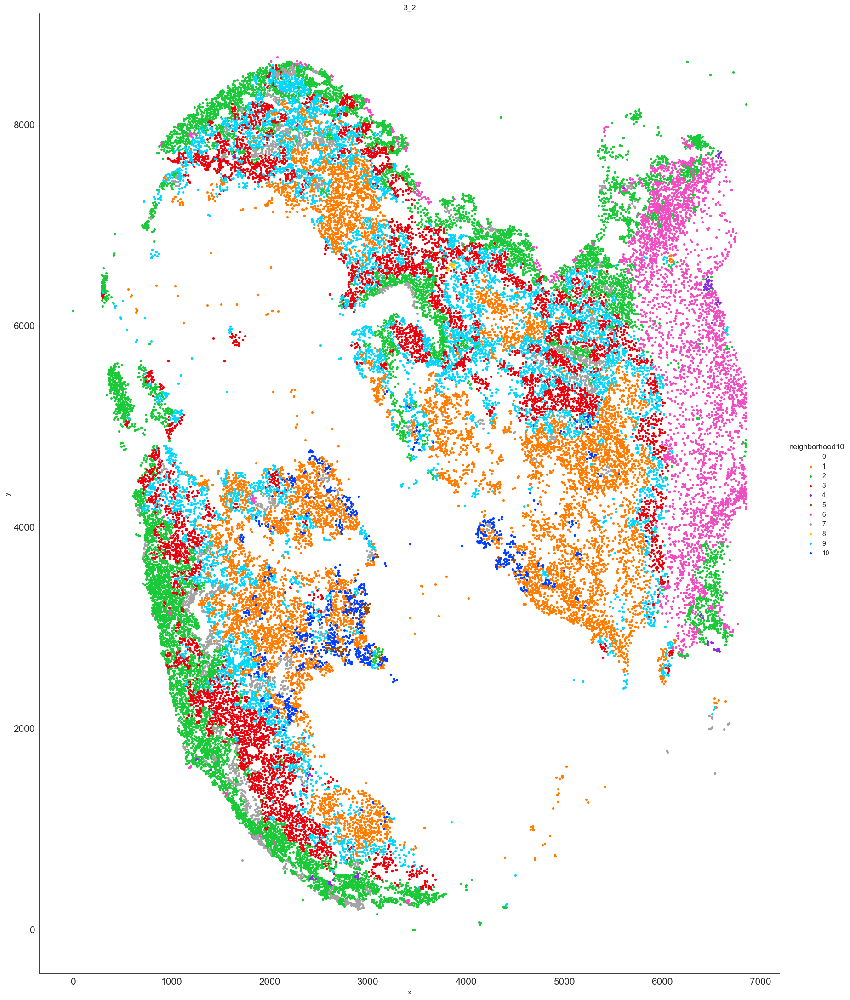

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_3


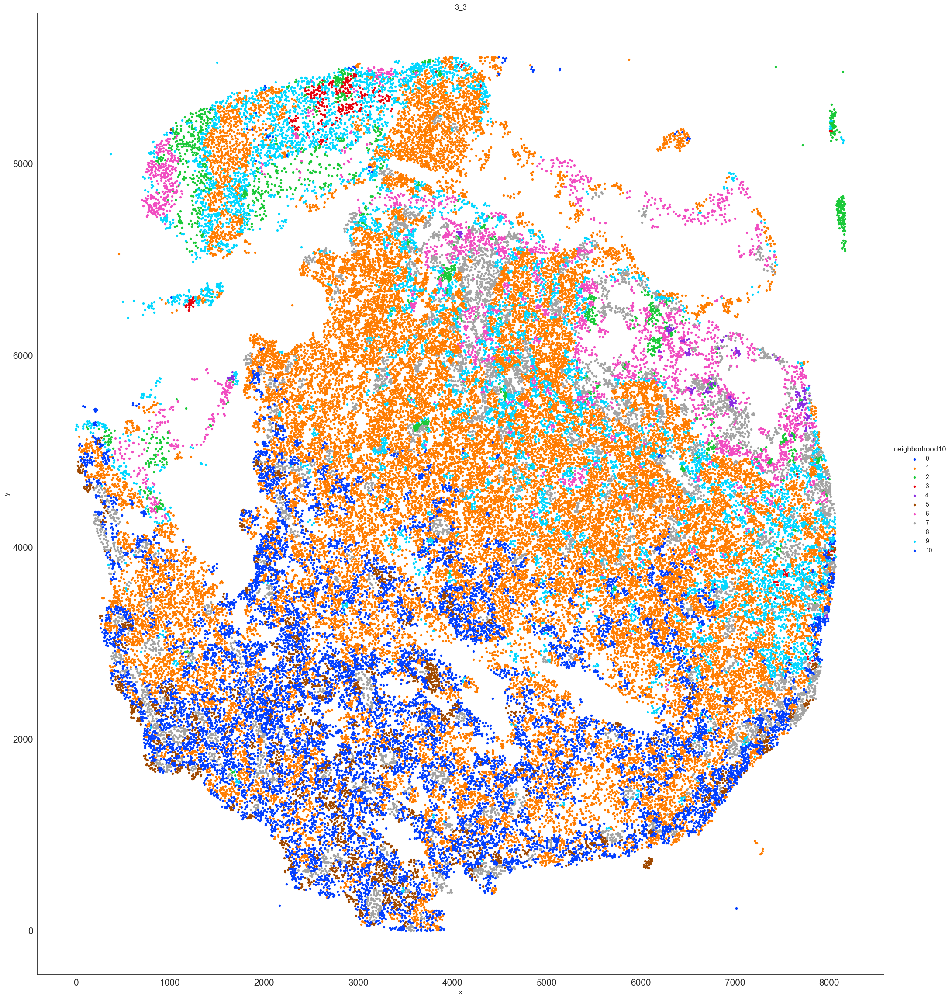

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_4


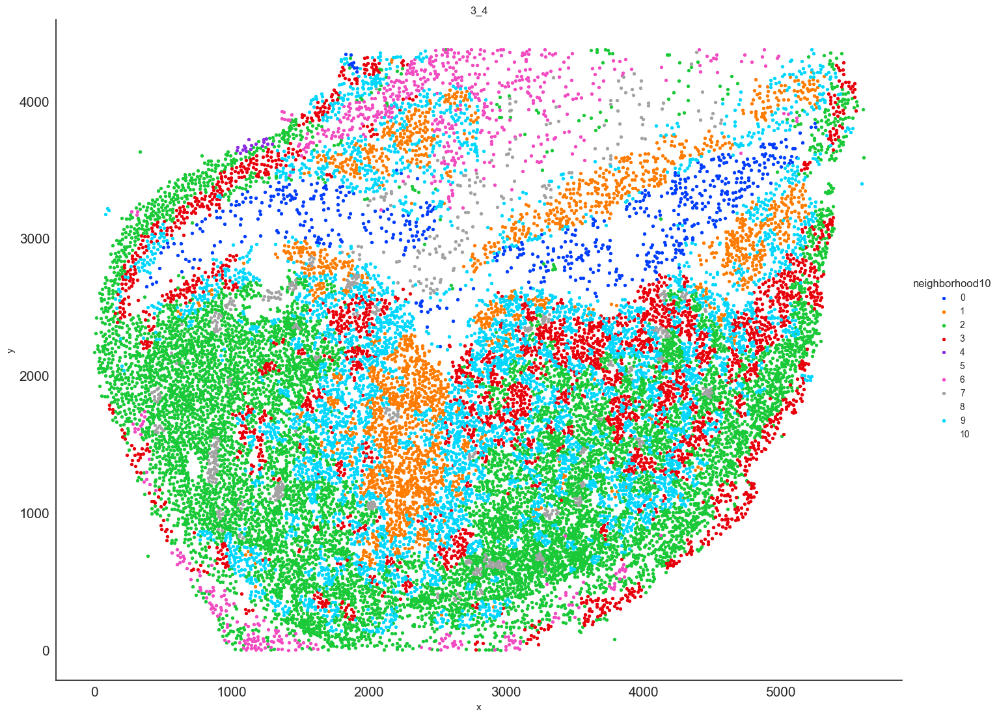

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_2


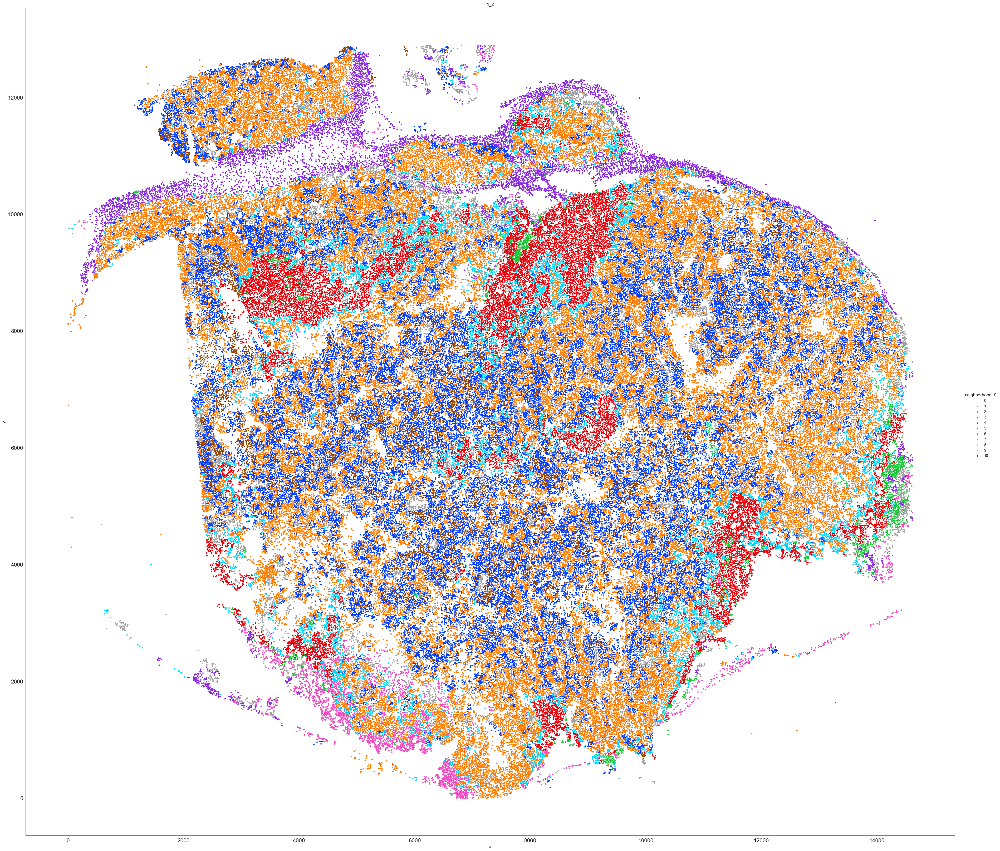

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_3


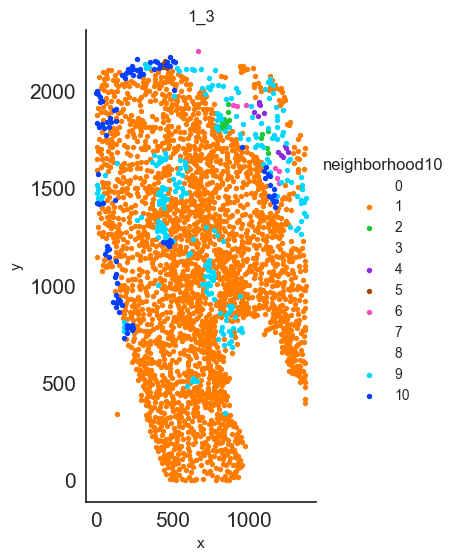

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_2


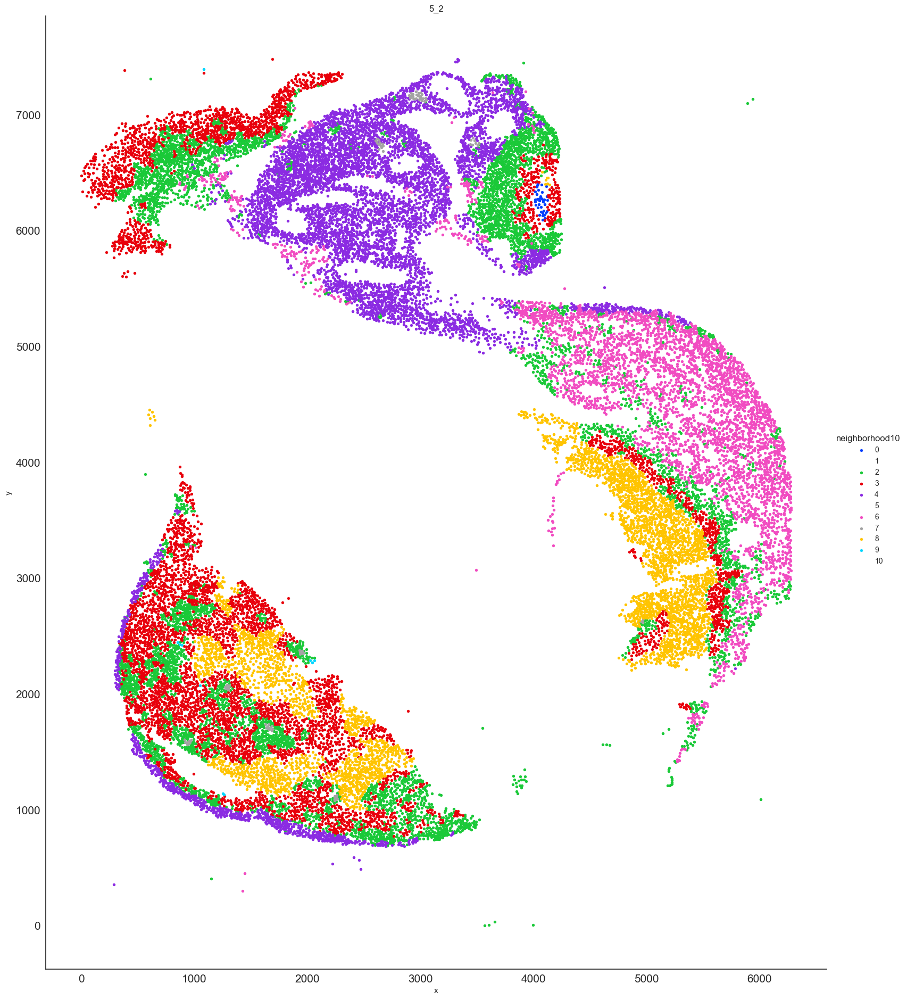

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_3


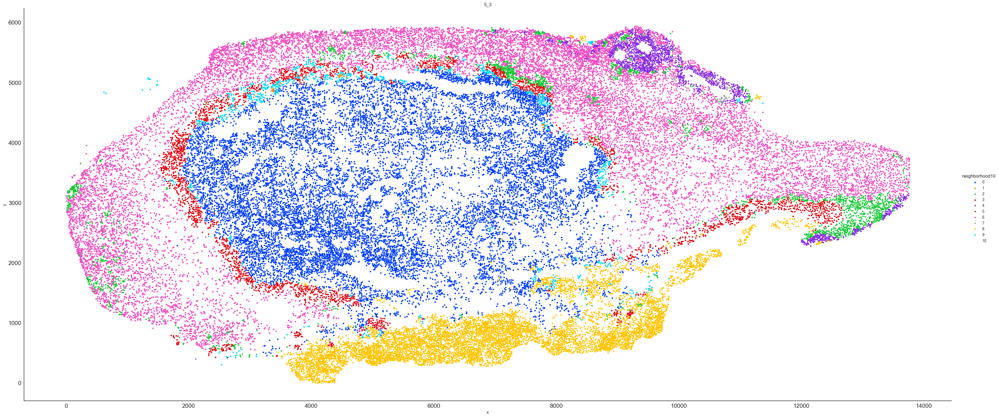

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_4


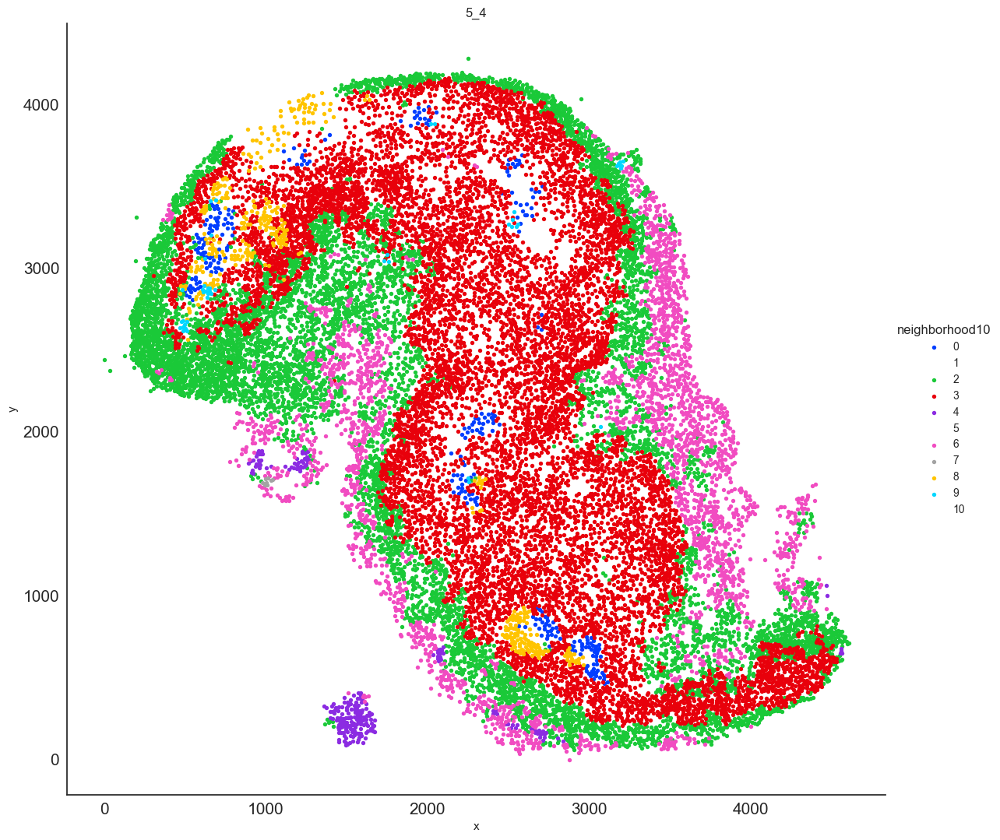

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_1_reg1


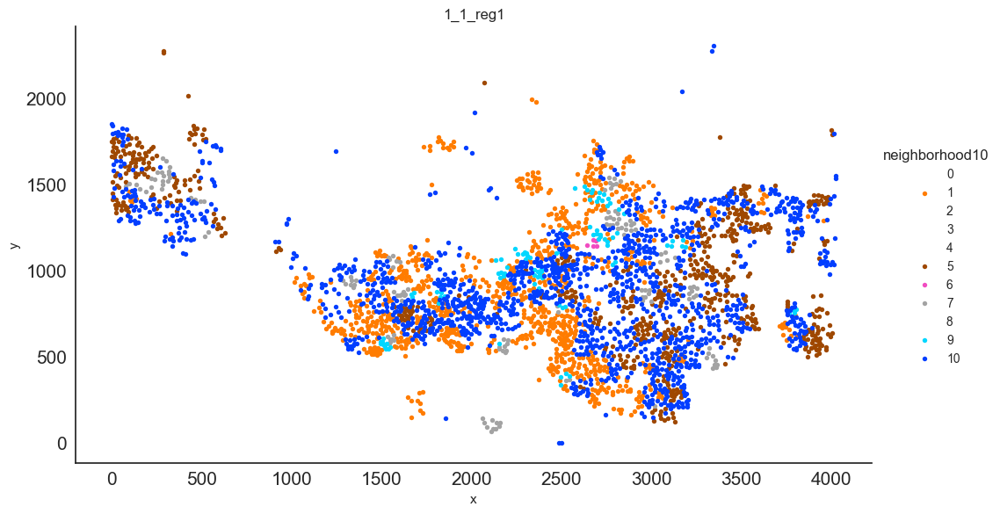

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg11


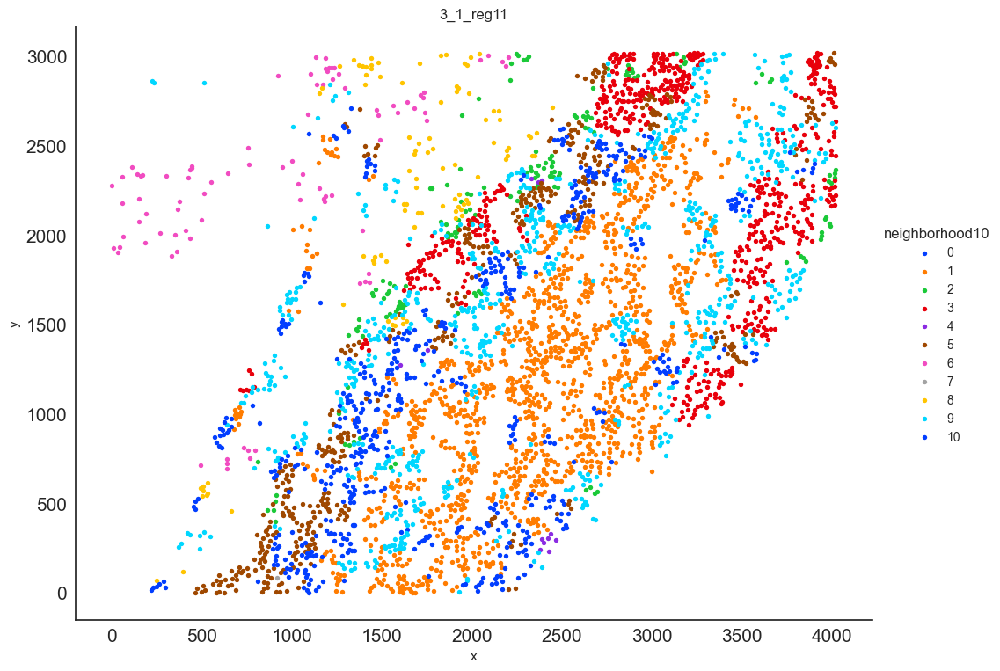

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg14


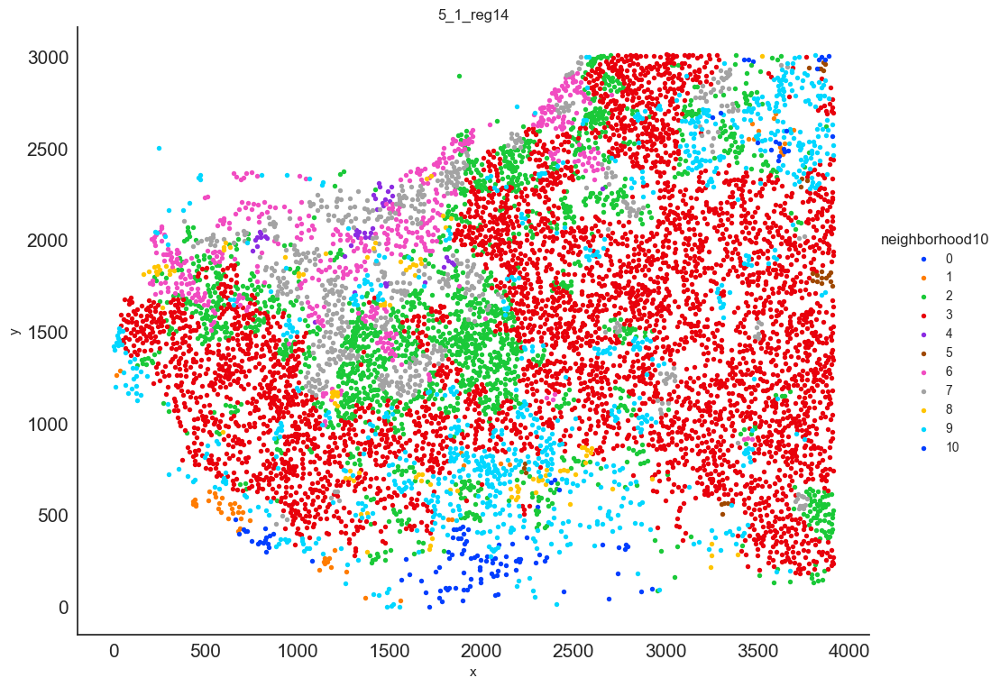

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg15


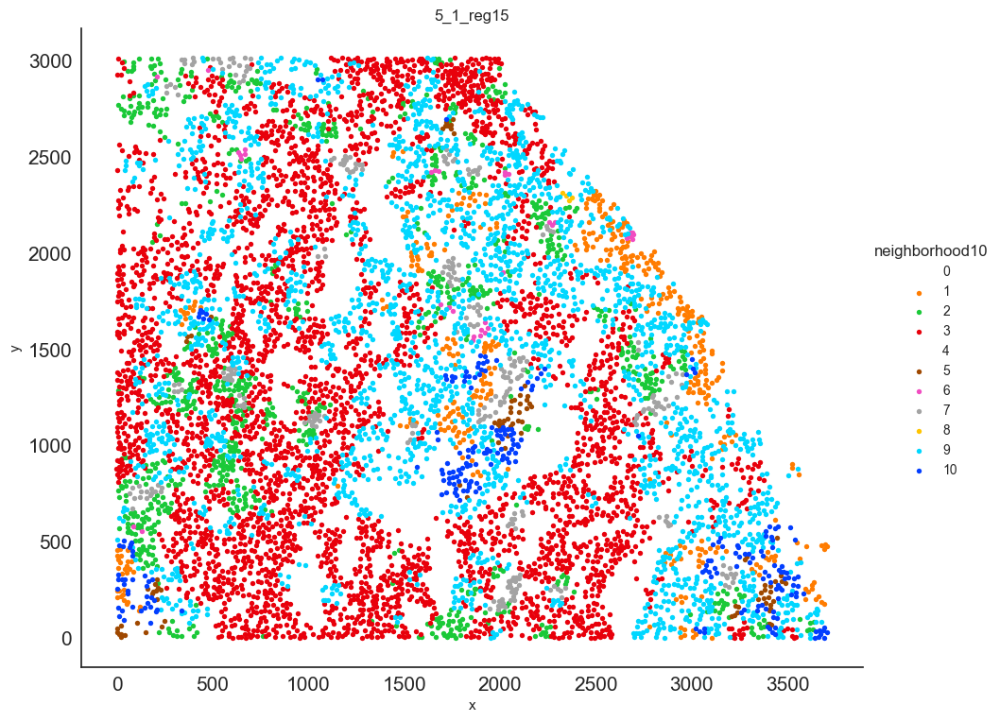

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg16


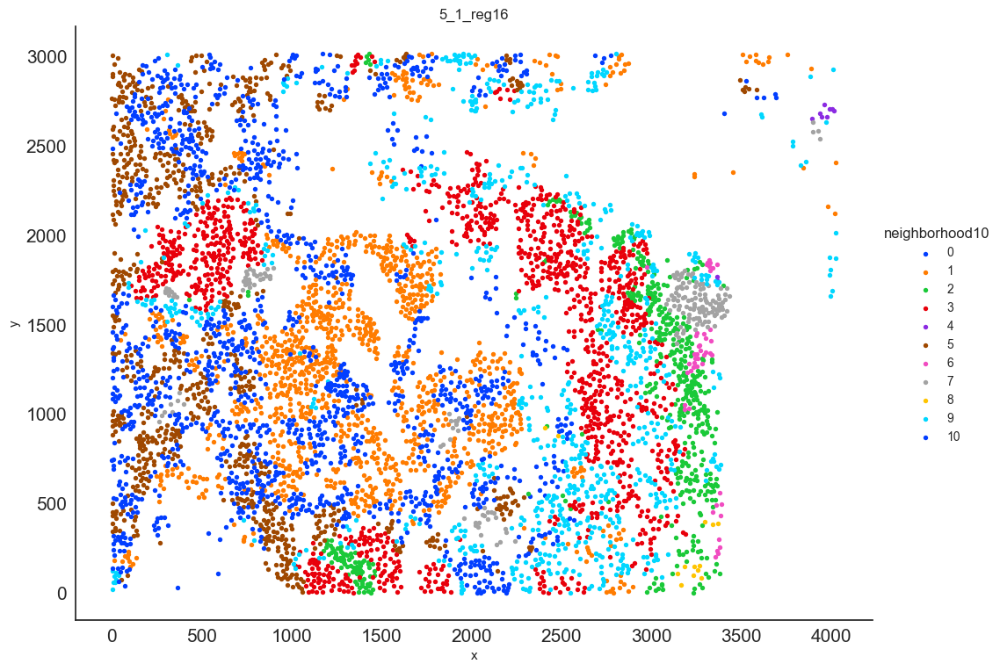

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg17


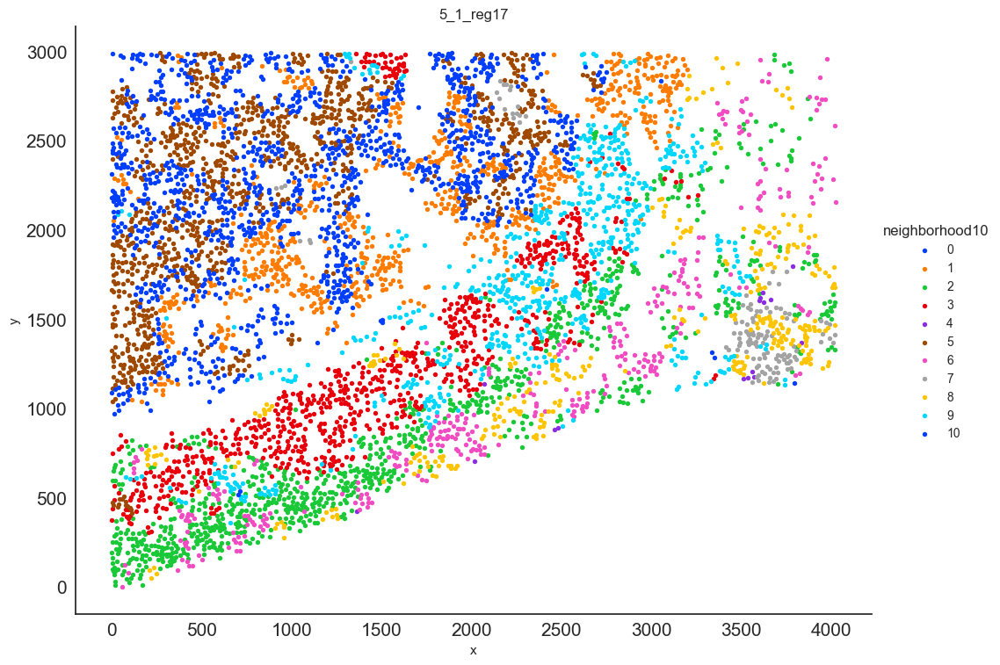

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg18


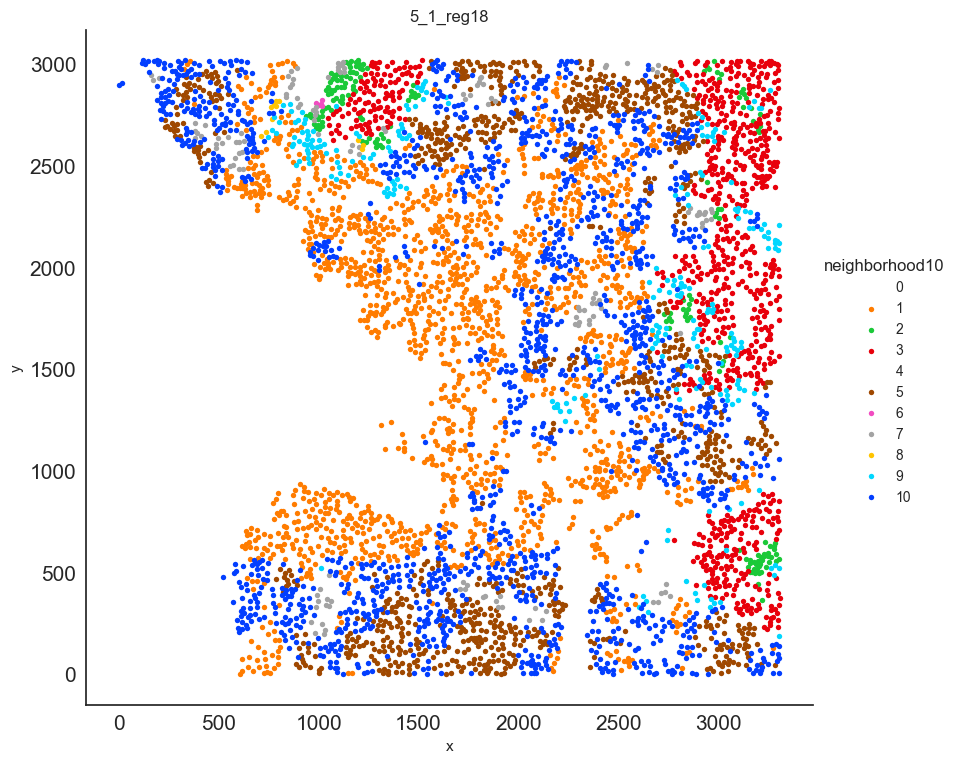

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg28


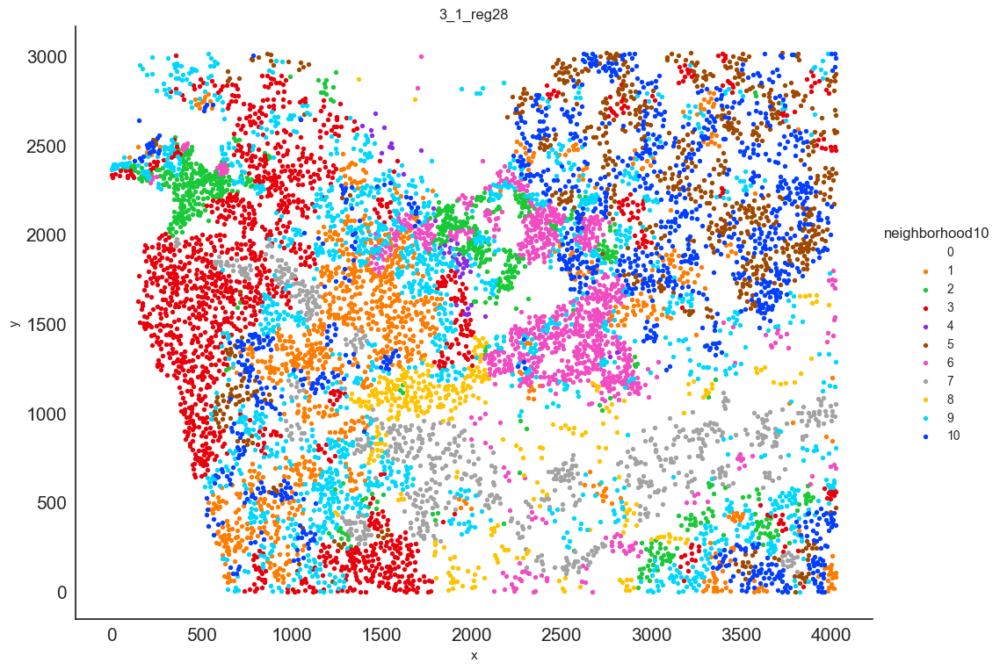

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg29


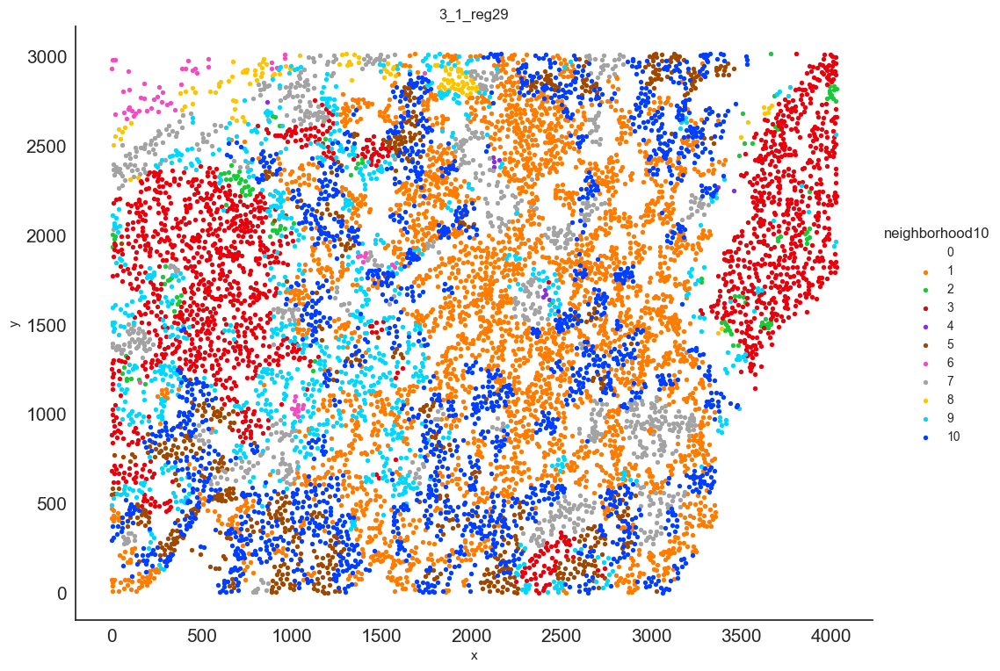

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg34


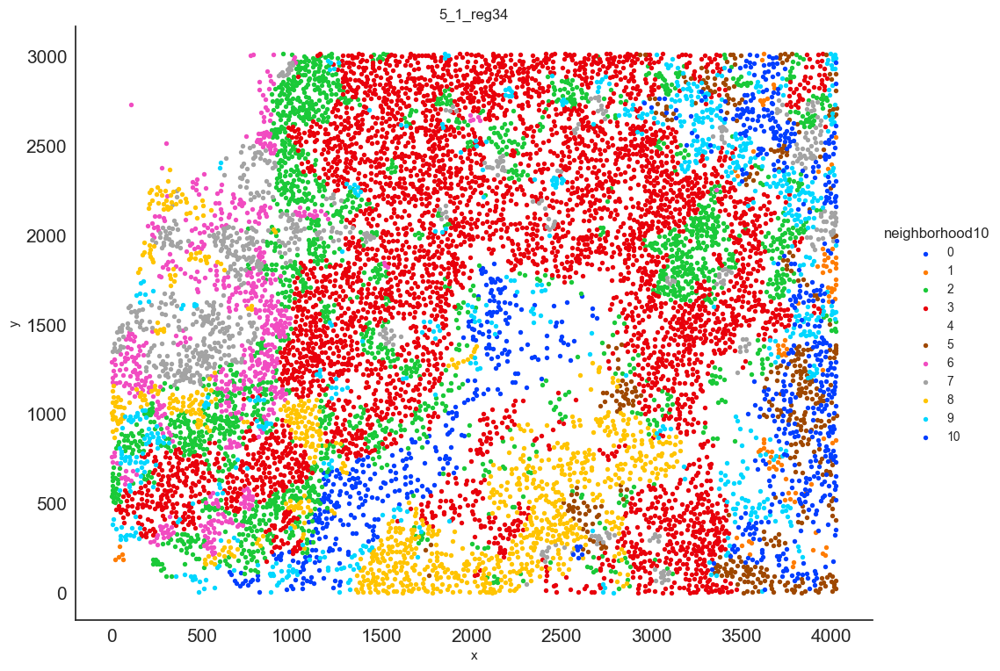

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg35


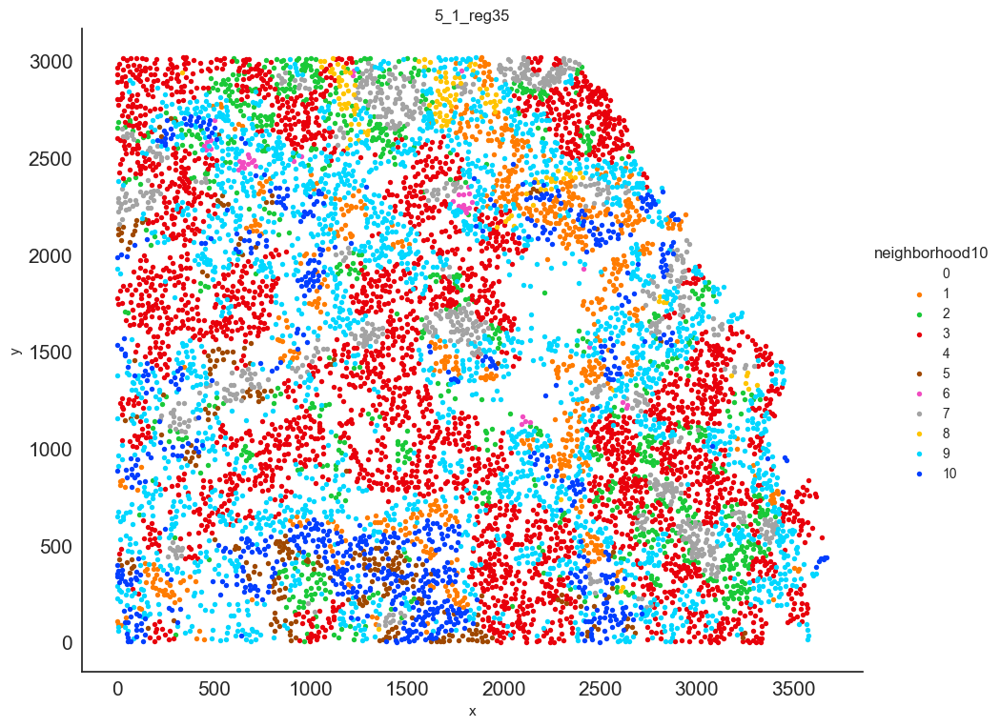

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg36


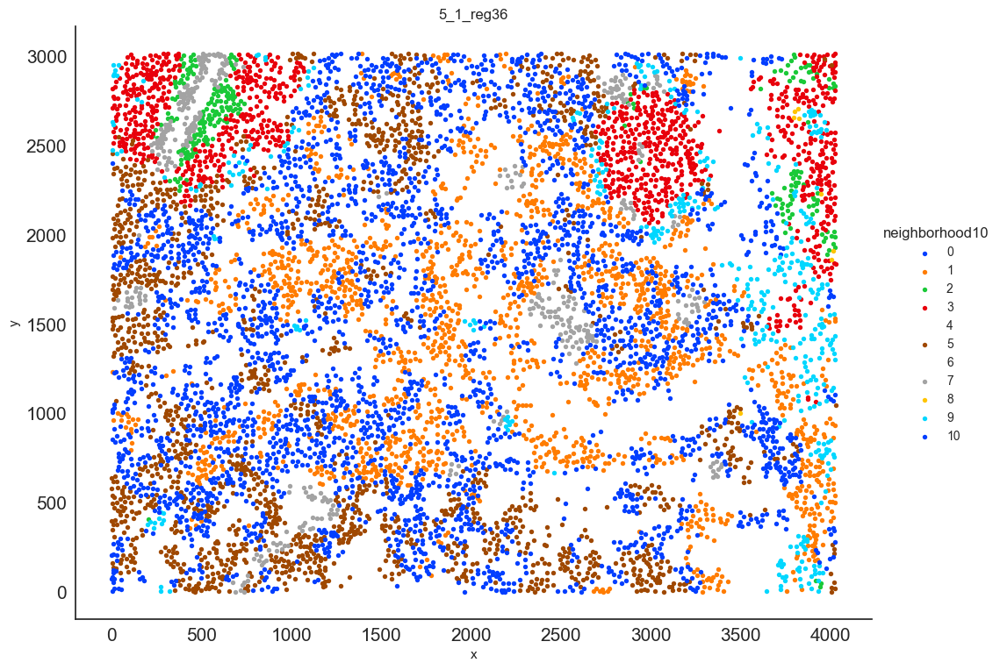

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg37


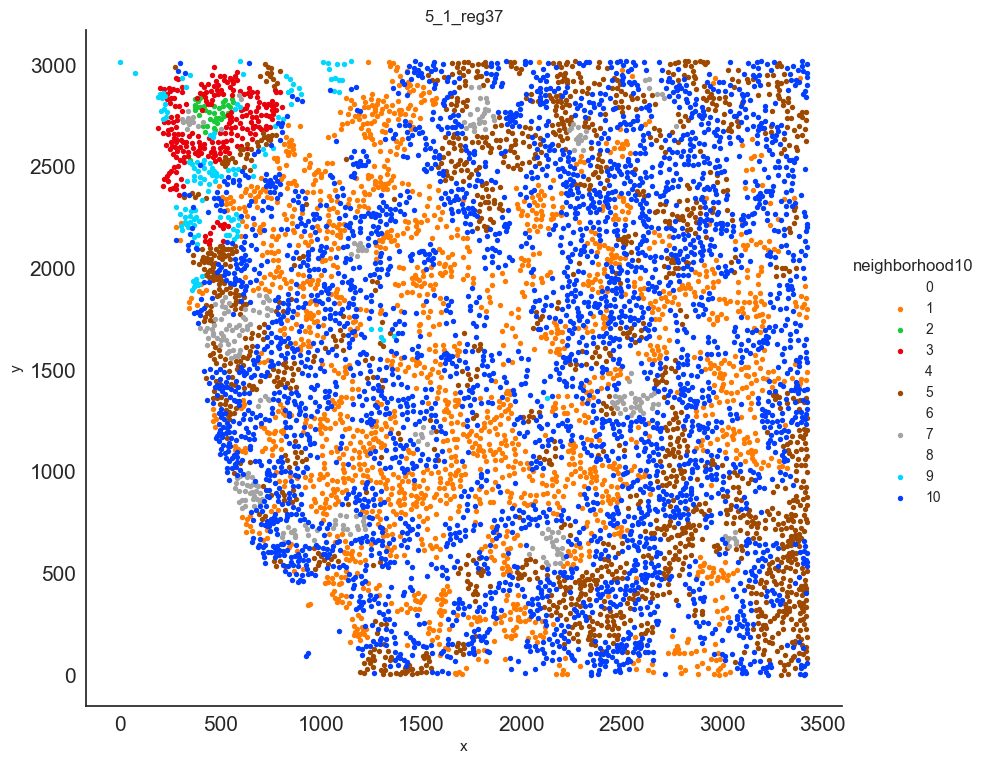

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_1_reg39


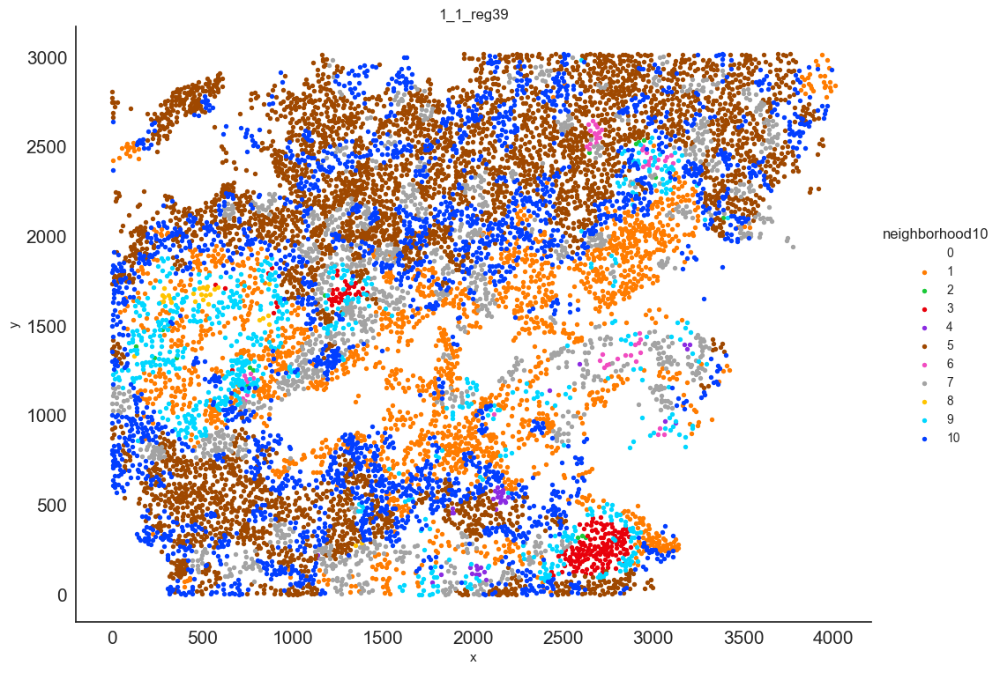

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg46


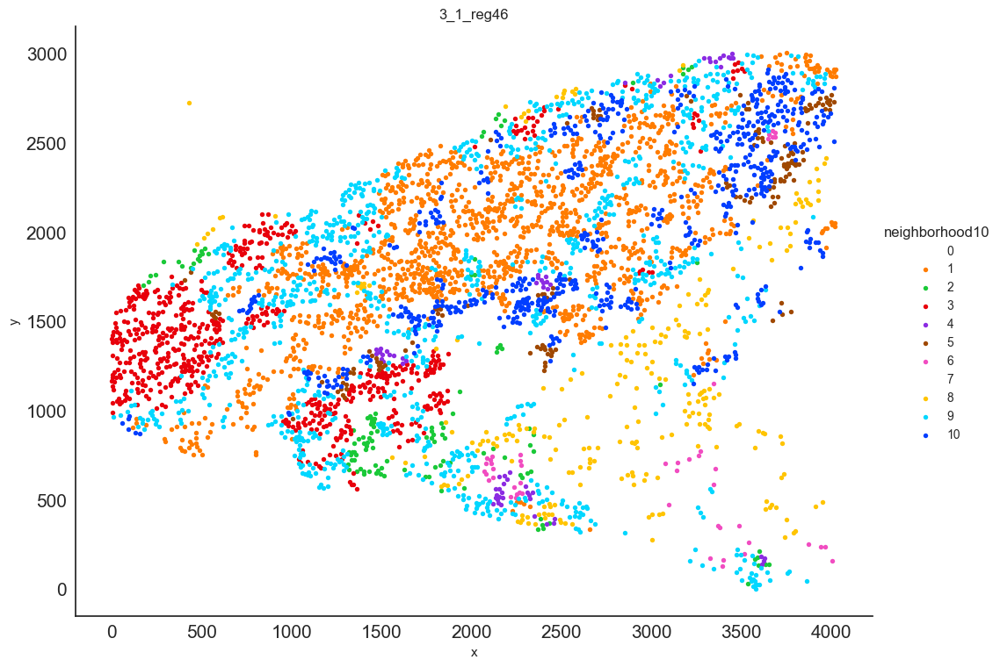

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg49


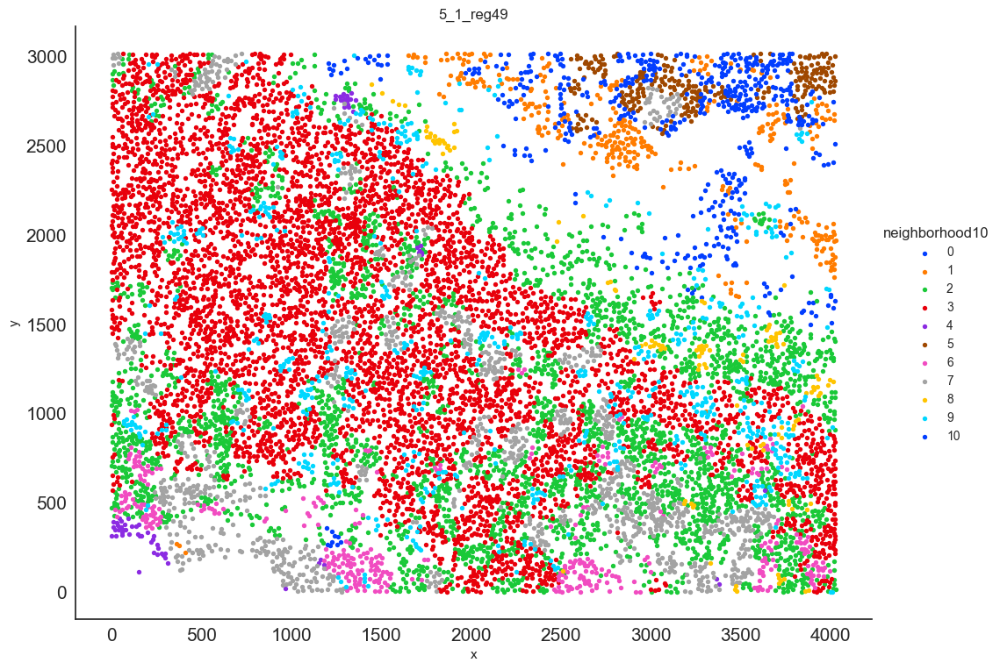

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg50


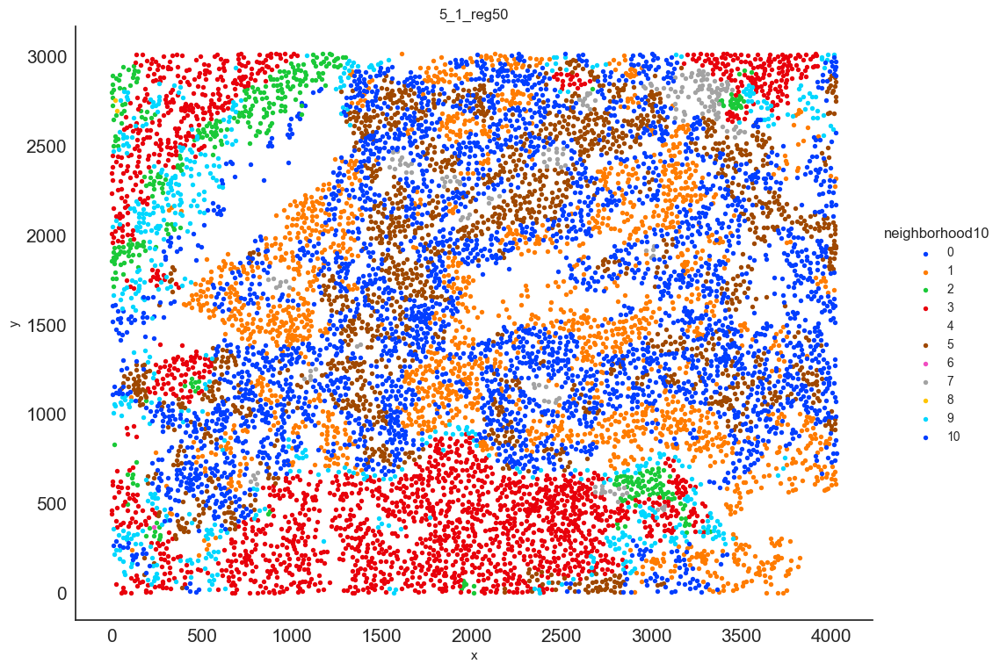

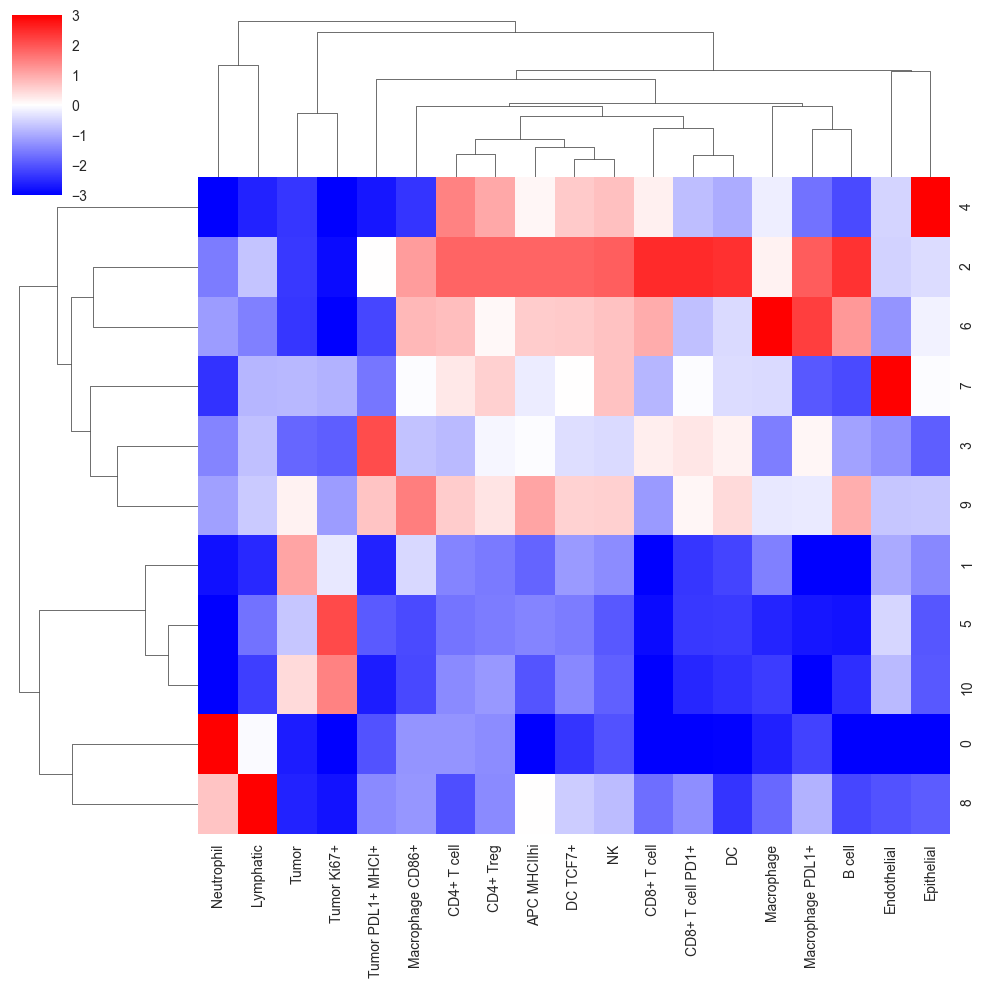

In [32]:
n_neighborhoods = 11 # test on 40 neighborhoods

cells_df, k_centroids = tl_neighborhood_analysis_2(data = df2, 
                           values = values, 
                           sum_cols = sum_cols, 
                           X = X, 
                           Y = Y, 
                           reg = reg, 
                           cluster_col = cluster_col, 
                           k = k, 
                           n_neighborhoods = n_neighborhoods,
                           elbow=False) 

pl_neighborhood_analysis_2(data = cells_df, 
                           k_centroids = k_centroids,
                           values = values, 
                           sum_cols = sum_cols, 
                           X = X, 
                           Y = Y, 
                           reg = reg, 
                           output_dir = output_dir, 
                           k = k, 
                           plot_specific_neighborhoods = None,
                           size= 60)

In [33]:
print(len(df["Neighborhood common"].unique()))
df["Neighborhood common"].unique()

11


array(['Inflamed Tumor', 'Inflamed Tumor & Immune', 'Tumor',
       'Immune Infiltrate', 'Ki67+ Tumor', 'Vasculature',
       'Inflamed Tumor & T cell', 'Vascularized Immune Infiltrate',
       'Macrophage Enriched Tumor', 'Epithelial & Immune Infiltrate',
       'Neutrophil Enriched'], dtype=object)

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:503: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  df_perc=(st/np.sum(st, axis = 1)[:,None])* 100


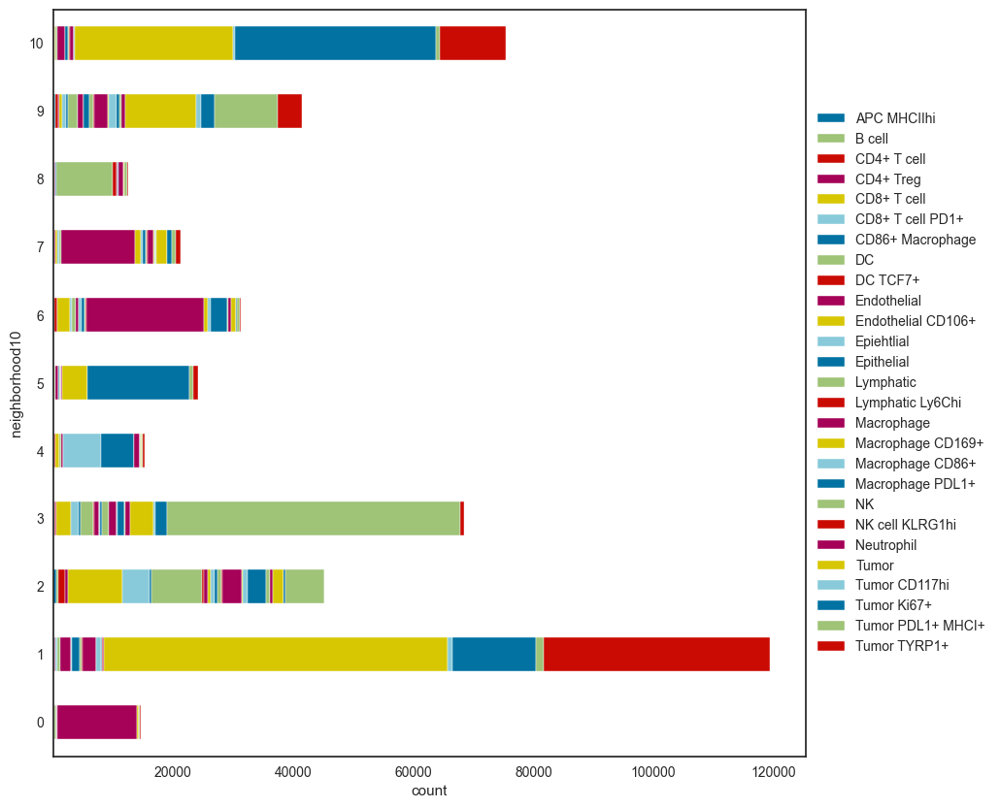

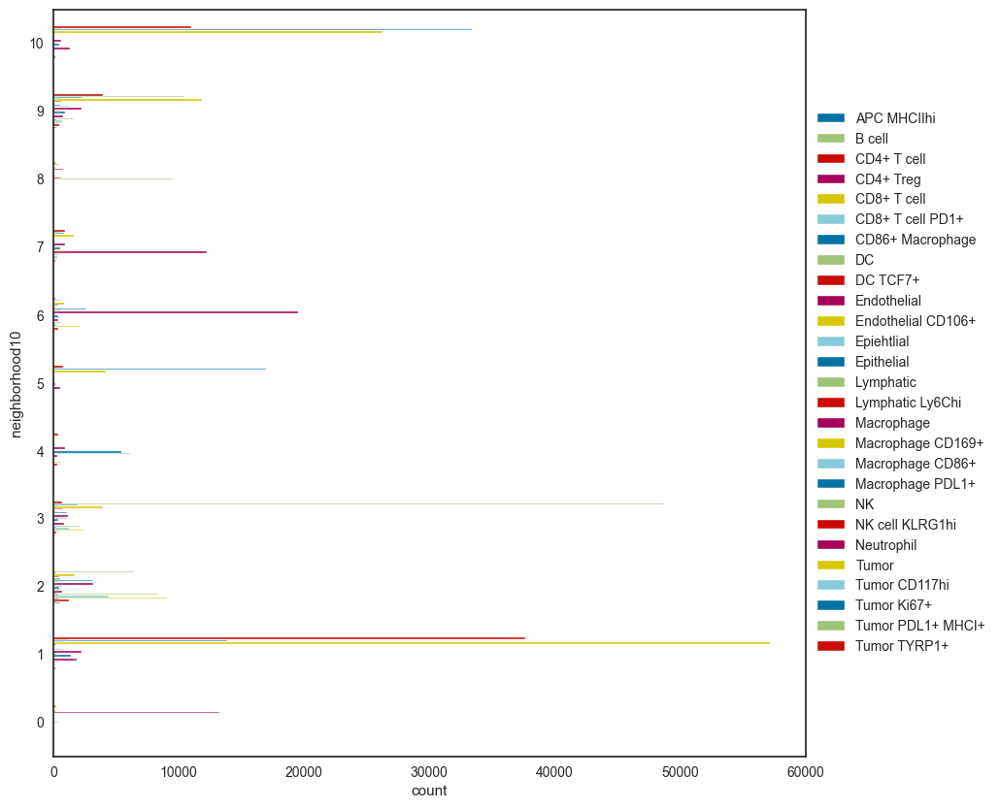

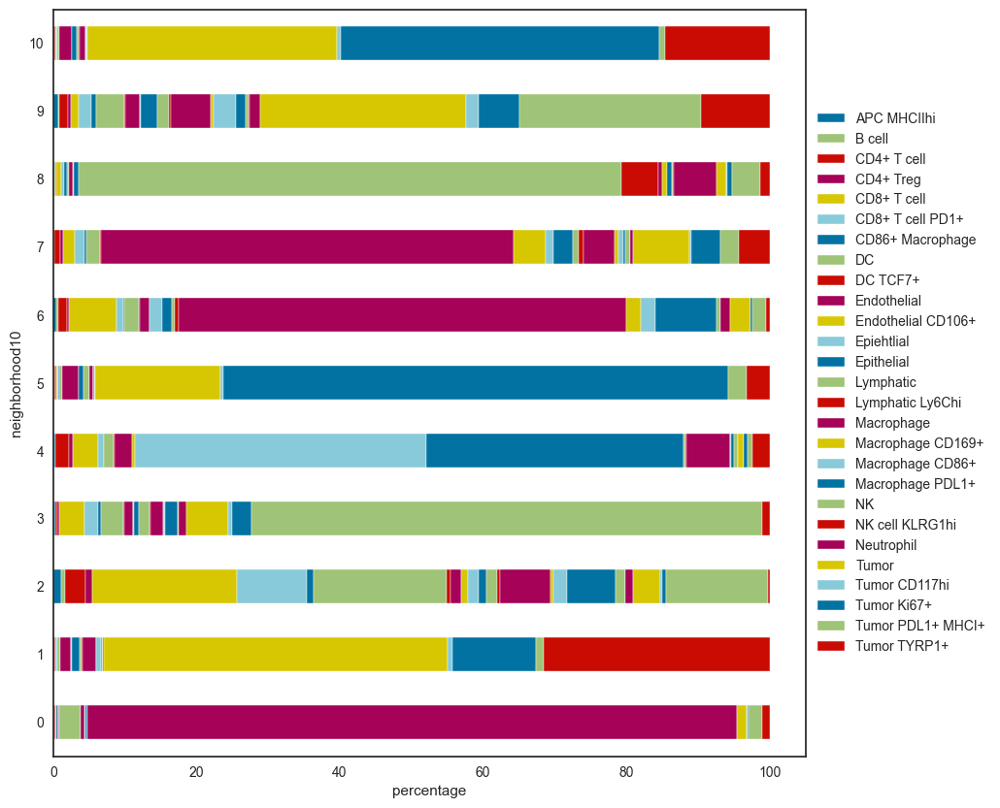

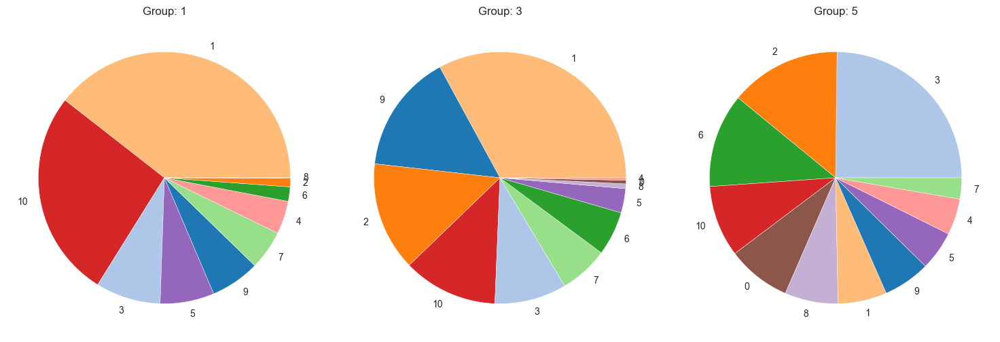

In [34]:
pl_cell_type_composition_vis(data = cells_df, \
                          sample_column = "neighborhood10", \
                          cell_type_column = "original cell type", \
                          output_dir = output_dir)
    
pl_create_pie_charts(cells_df, "day harvested", "neighborhood10", show_percentages=False)

## Clustering into communities 

In [35]:
# Community analysis
# Arguments for community analysis:
data = cells_df
X = X
Y = Y
reg = "unique_region"
cluster_col_commun = "Neighborhood common"
# ks_commun = [10] # k=n means it collects n nearest neighbors for each center cell
output_dir = output_dir
k_commun = 100
n_communities_commun = 8
plot_specific_community = [2,4,5]
df2 = pd.concat([df,pd.get_dummies(df[cluster_col_commun])],1)
sum_cols = df2[cluster_col_commun].unique()
values = df2[sum_cols].values
k_centroids = {}

/var/folders/6d/0x48qjh15rx9851lpdwvrxvc0000gn/T/ipykernel_27161/2266081328.py:13: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  df2 = pd.concat([df,pd.get_dummies(df[cluster_col_commun])],1)


Starting: 9/25 : 1_1_reg1
Finishing: 9/25 : 1_1_reg1 0.06580495834350586 0.06765294075012207
Starting: 22/25 : 1_1_reg39
Finishing: 22/25 : 1_1_reg39 0.18844079971313477 0.2628340721130371
Starting: 4/25 : 1_2
Finishing: 4/25 : 1_2 2.8619420528411865 3.1312336921691895
Starting: 5/25 : 1_3
Finishing: 5/25 : 1_3 0.048011064529418945 3.2374520301818848
Starting: 10/25 : 3_1_reg11
Finishing: 10/25 : 3_1_reg11 0.0917670726776123 3.3361411094665527
Starting: 16/25 : 3_1_reg28
Finishing: 16/25 : 3_1_reg28 0.13897085189819336 3.48396897315979
Starting: 17/25 : 3_1_reg29
Finishing: 17/25 : 3_1_reg29 0.14960789680480957 3.6384267807006836
Starting: 23/25 : 3_1_reg46
Finishing: 23/25 : 3_1_reg46 0.07438397407531738 3.7174599170684814
Starting: 1/25 : 3_2
Finishing: 1/25 : 3_2 0.5235741138458252 4.244294166564941
Starting: 2/25 : 3_3
Finishing: 2/25 : 3_3 1.007761001586914 5.2714879512786865
Starting: 3/25 : 3_4
Finishing: 3/25 : 3_4 0.39731621742248535 5.7023420333862305
Starting: 11/25 : 5_1_re

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:243: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([pd.DataFrame(out_dict[(exp, k)][0], index=out_dict[(exp, k)][1].astype(int), columns=sum_cols) for exp in exps], 0)
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_tools_tl.py:245: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  window = pd.concat([data[keep_cols], window], 1)
/Users/timnoahkempchen/opt/anaconda3/envs/spatial_analysis_environment/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWith

3_2


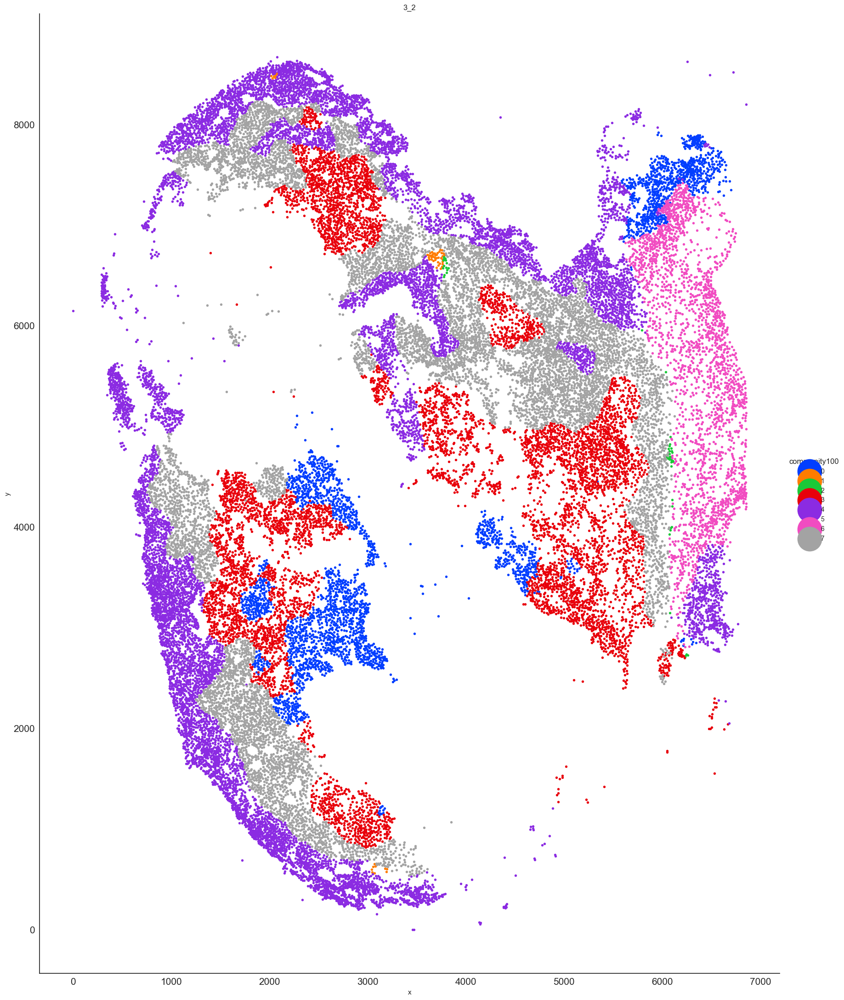

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_3


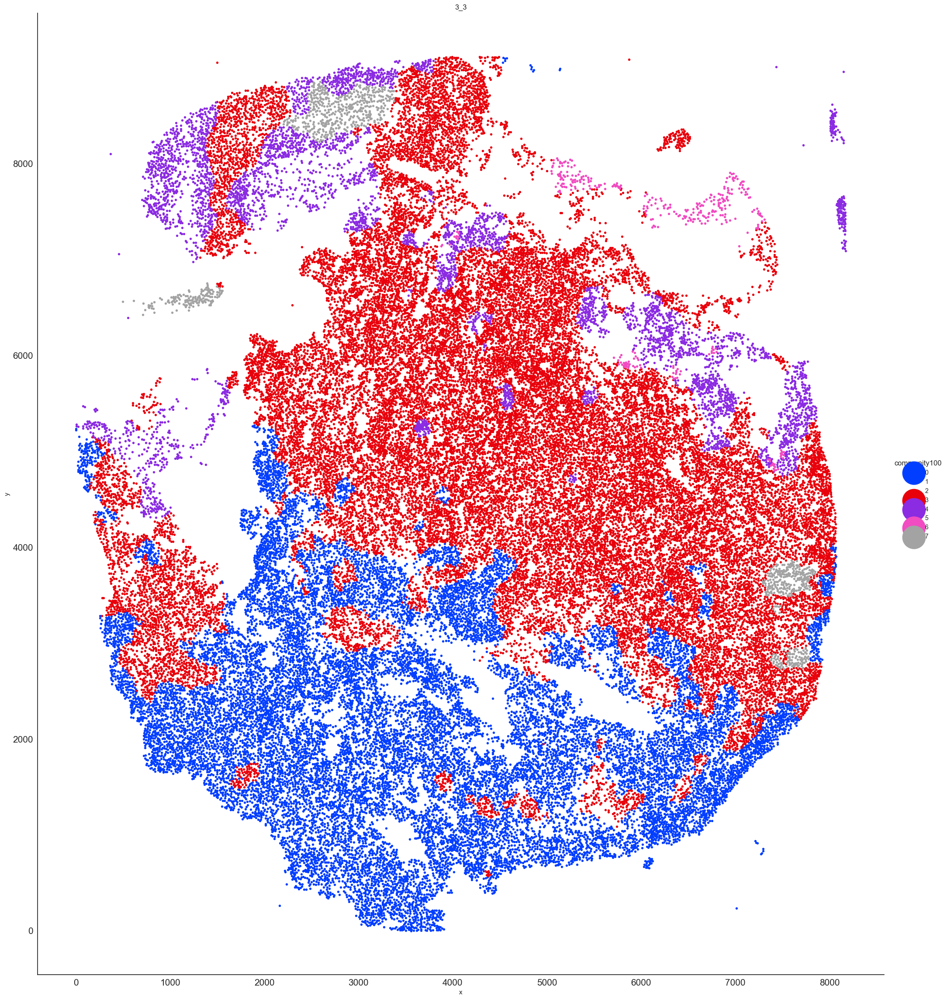

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_4


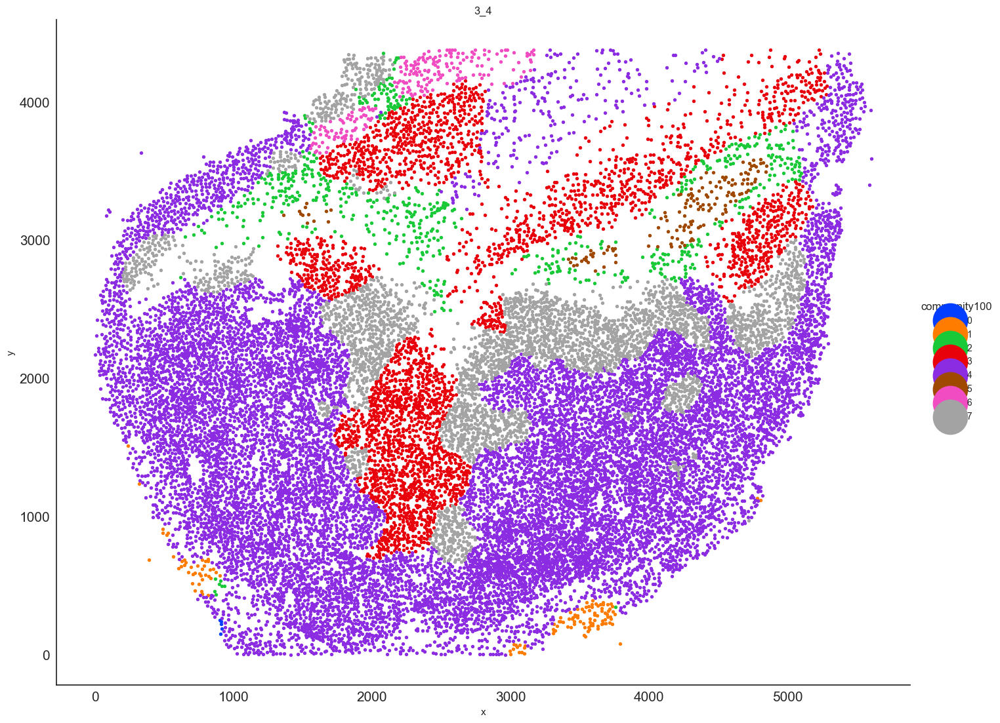

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_2


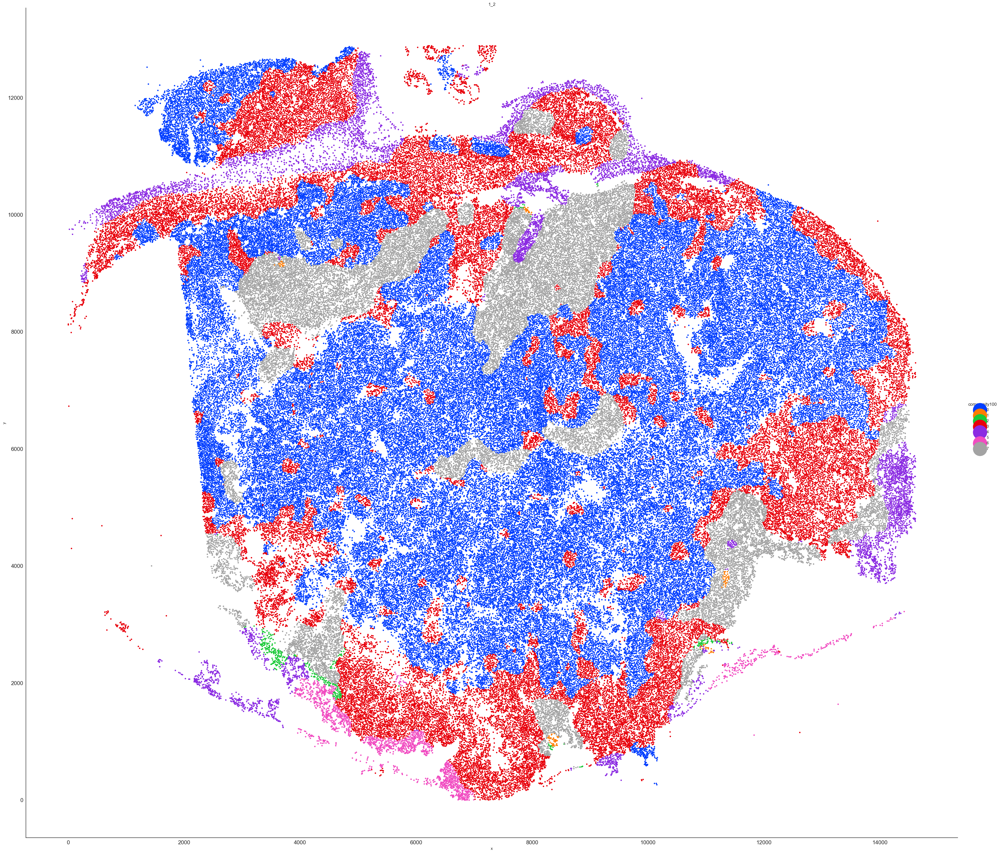

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_3


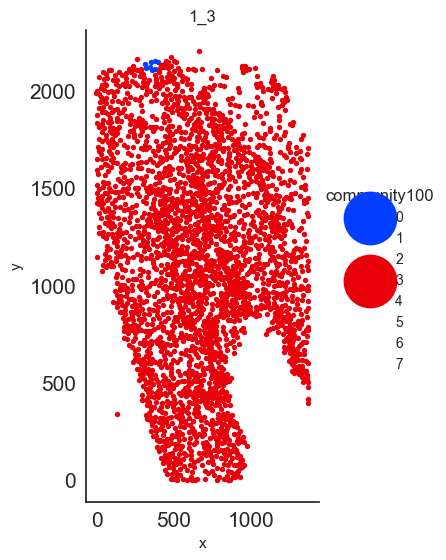

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_2


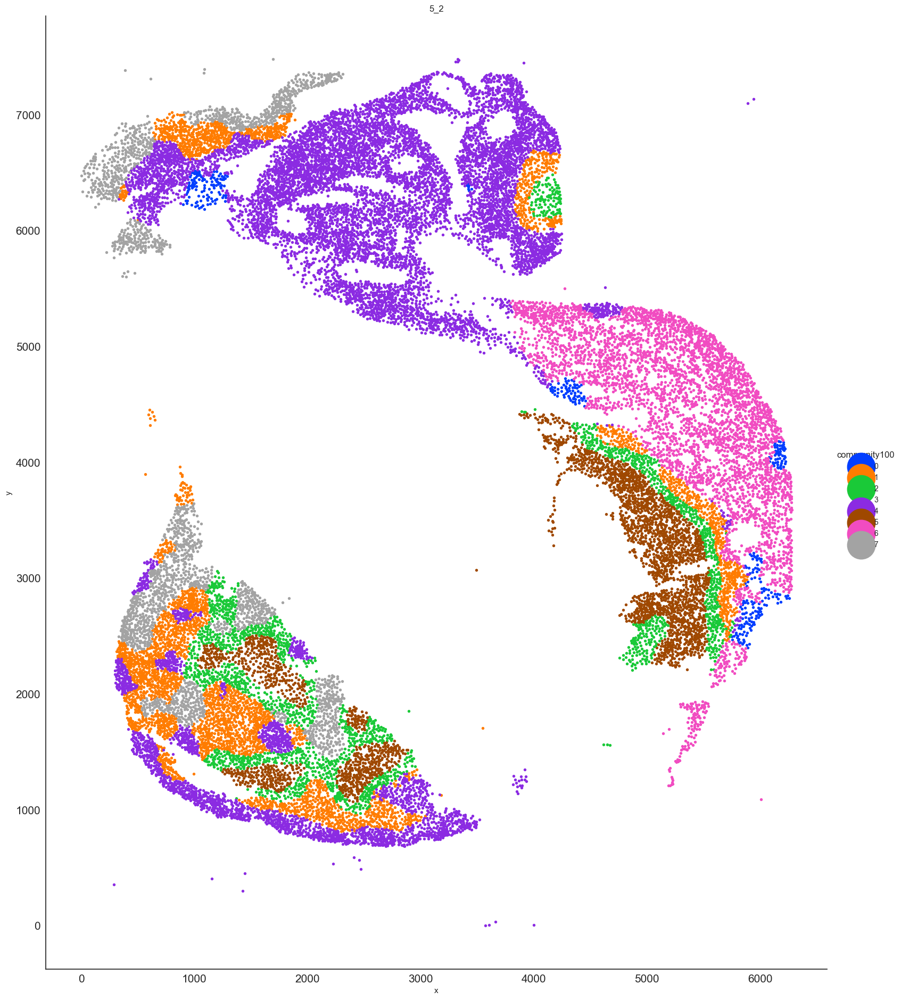

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_3


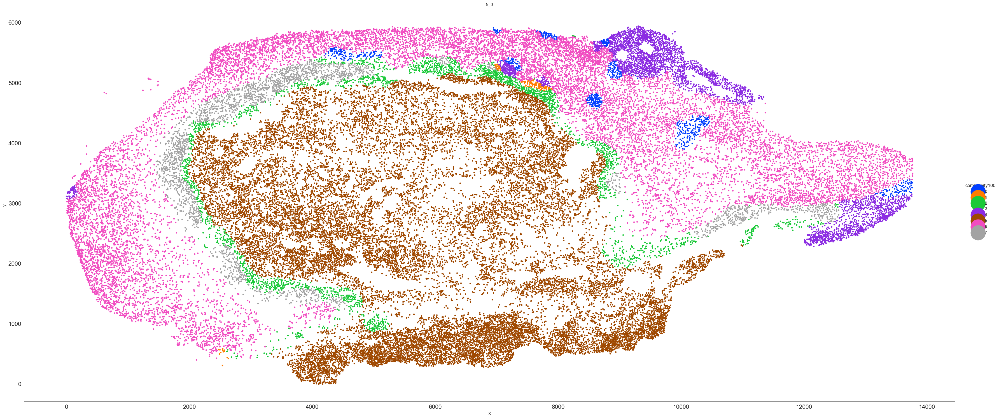

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_4


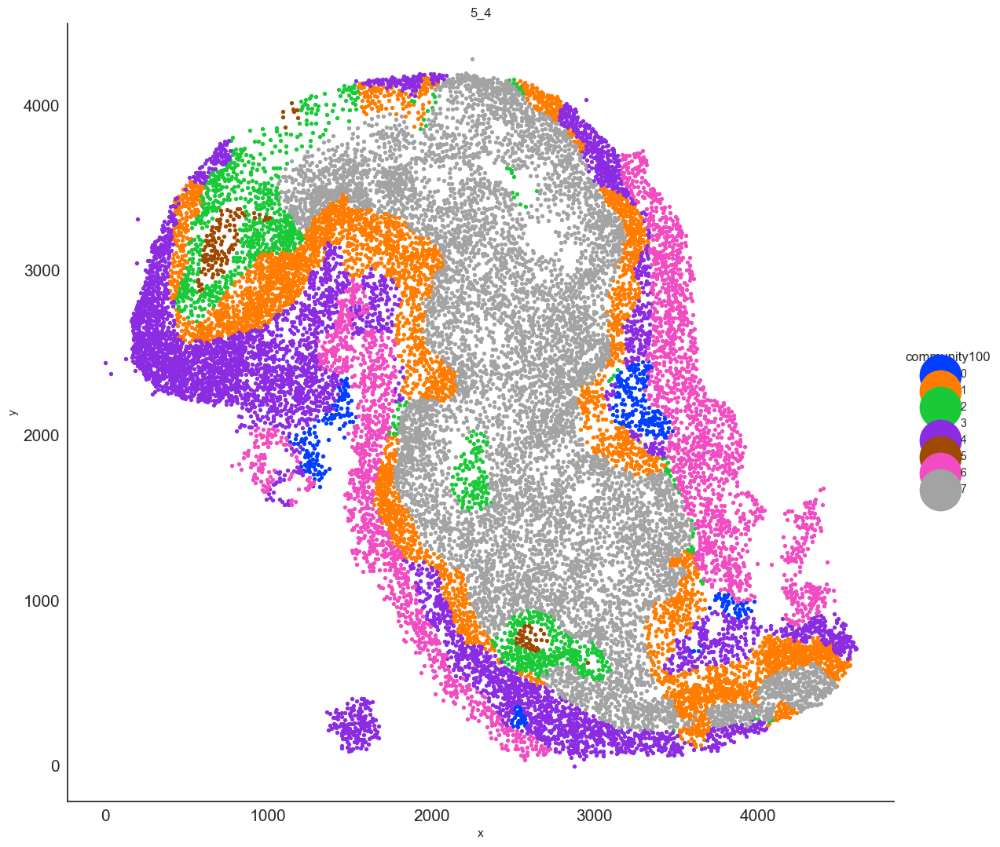

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_1_reg1


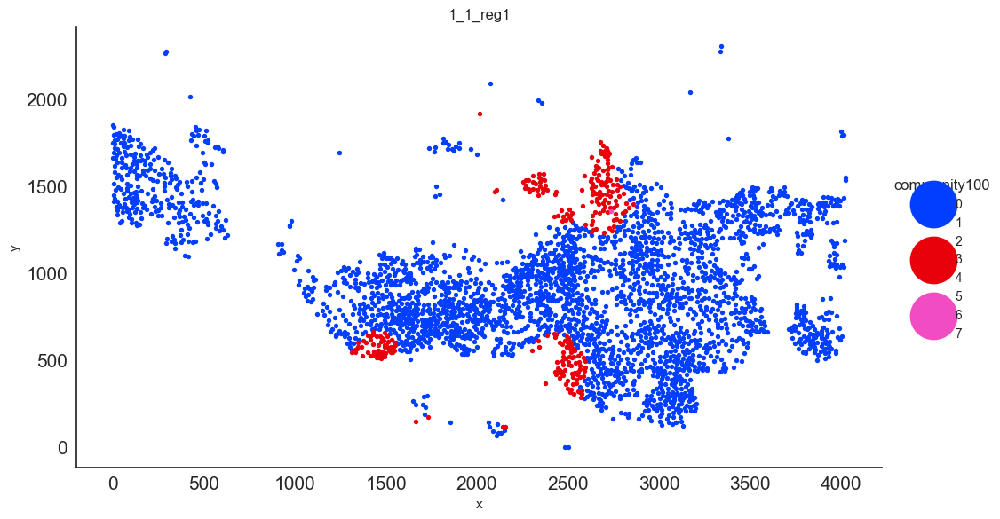

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg11


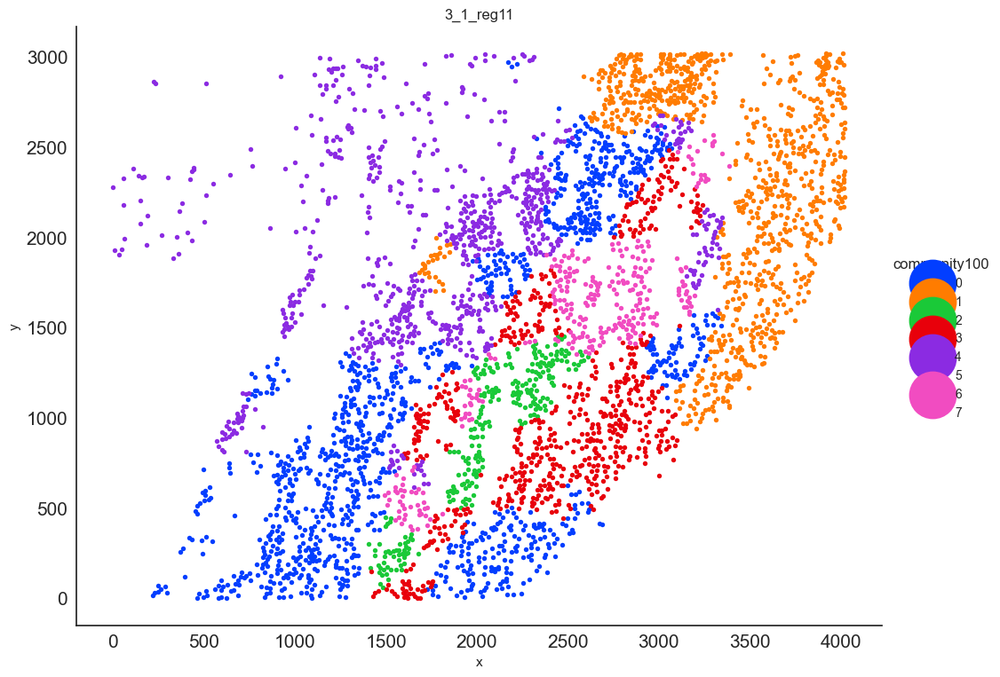

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg14


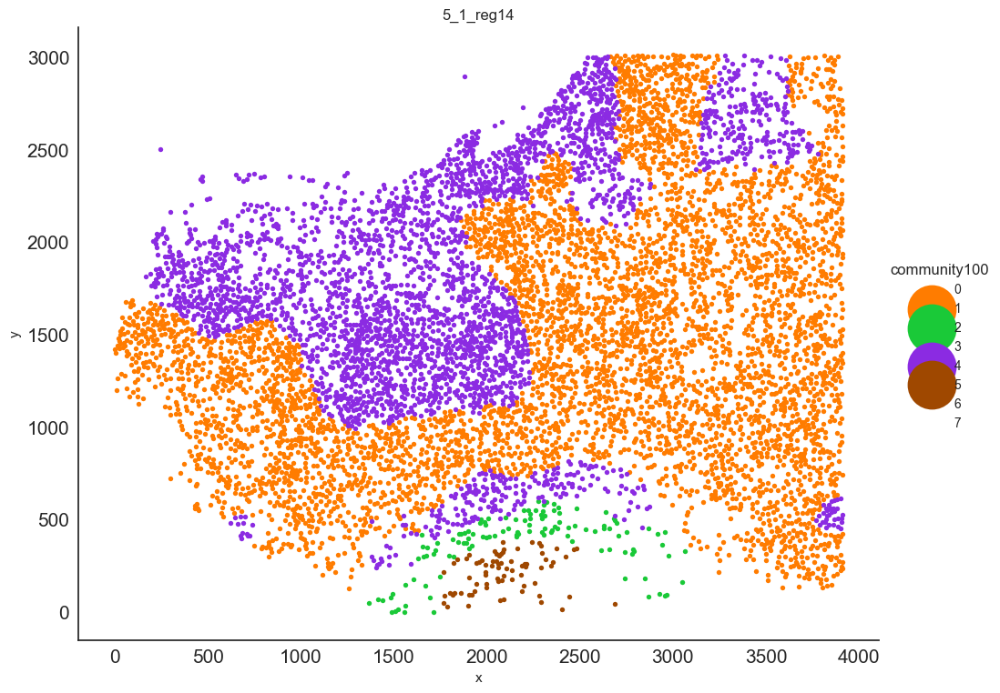

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg15


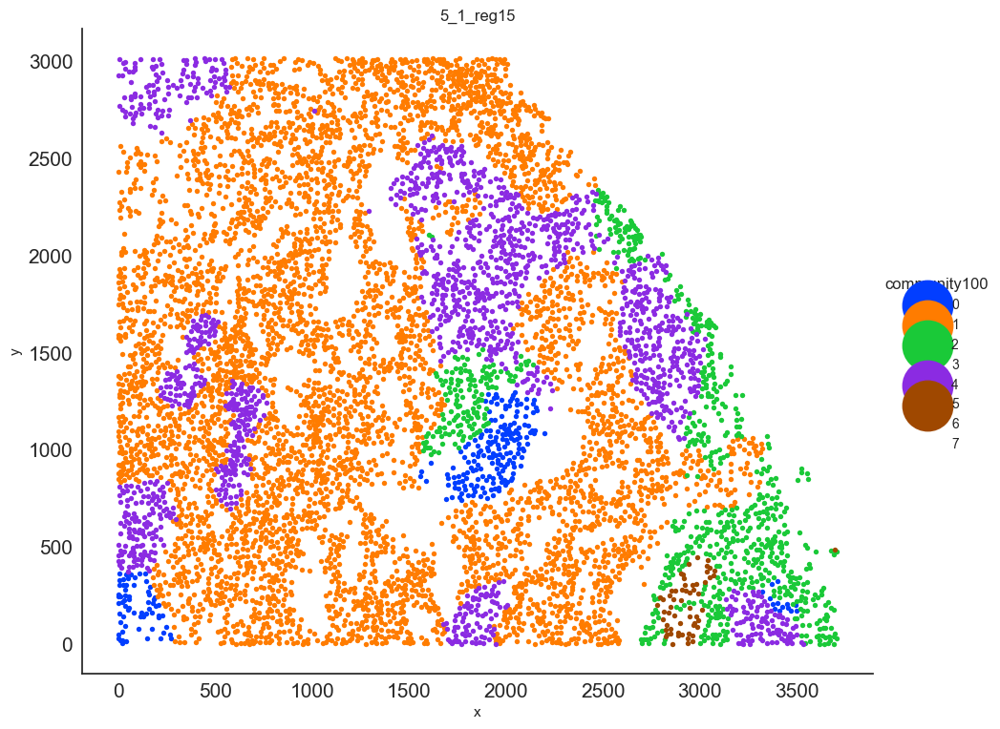

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg16


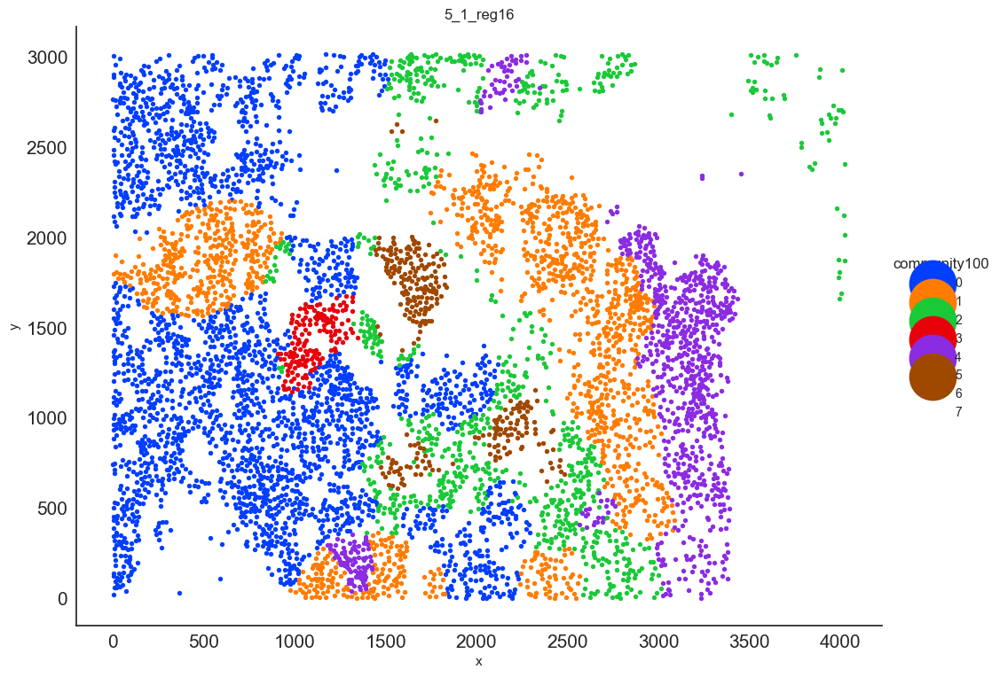

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg17


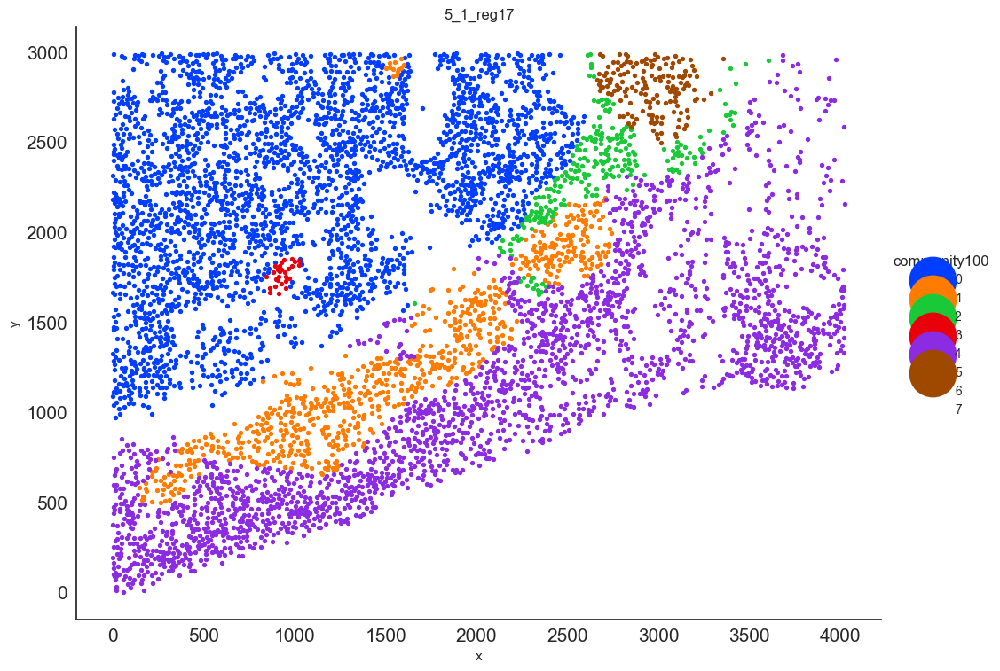

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg18


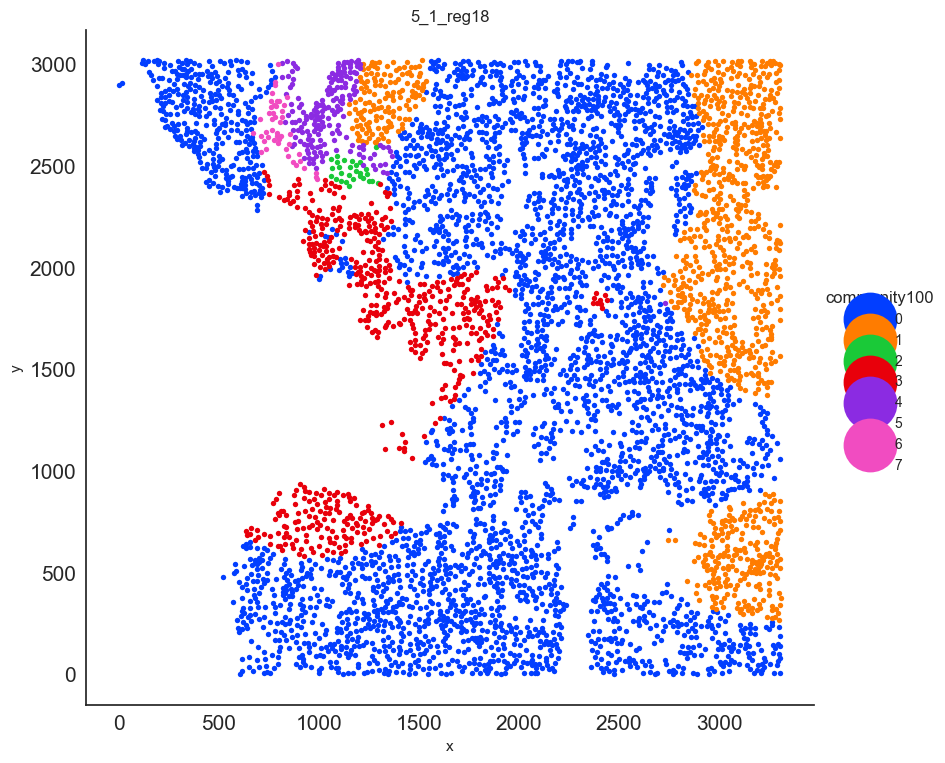

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg28


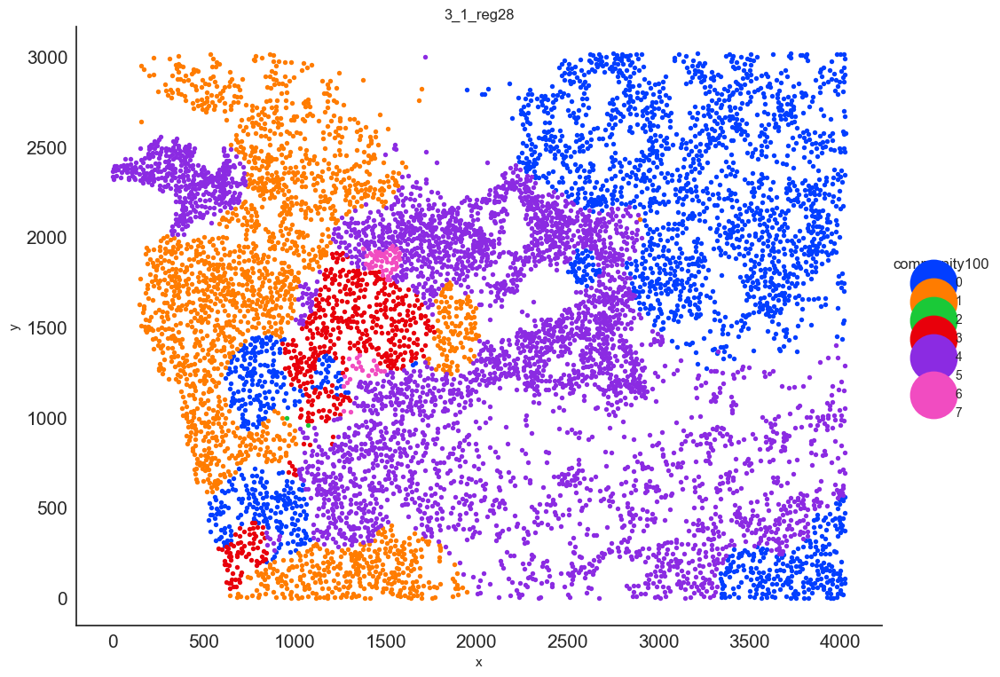

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg29


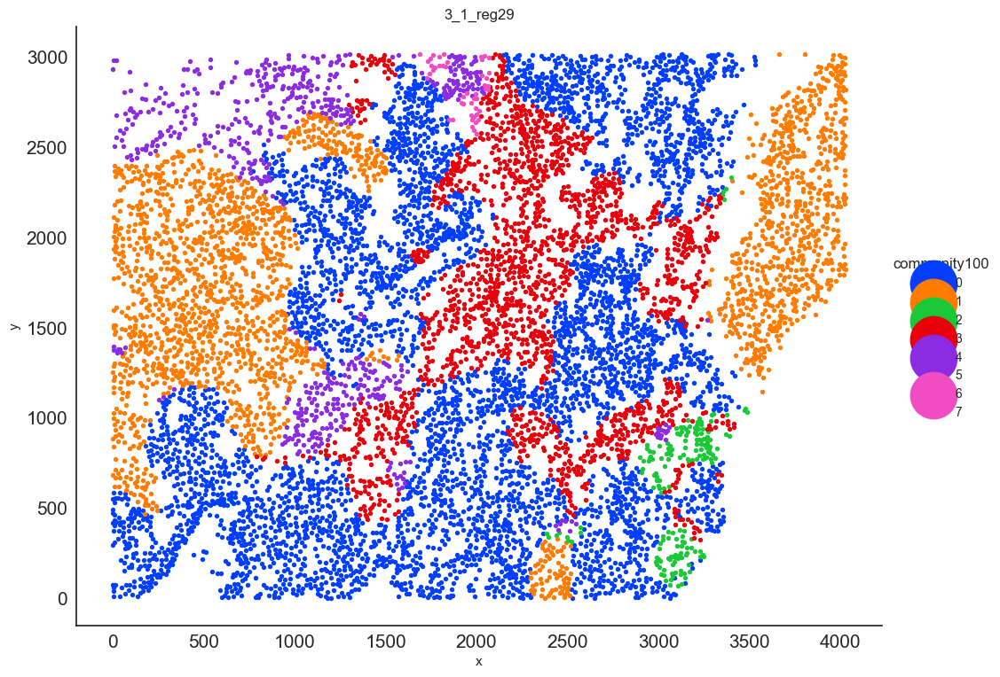

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg34


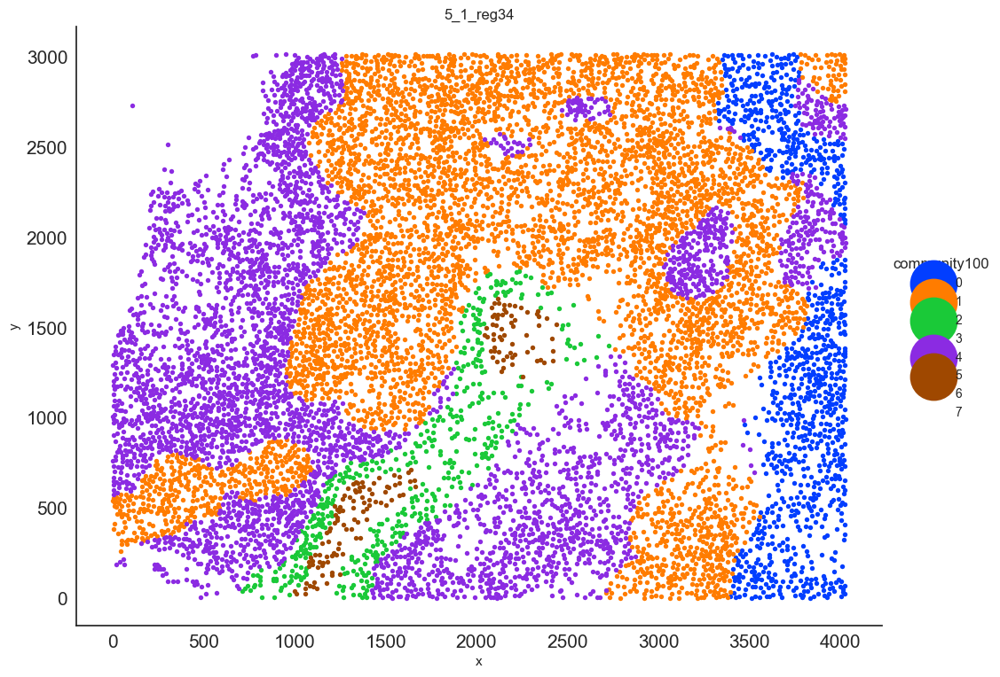

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg35


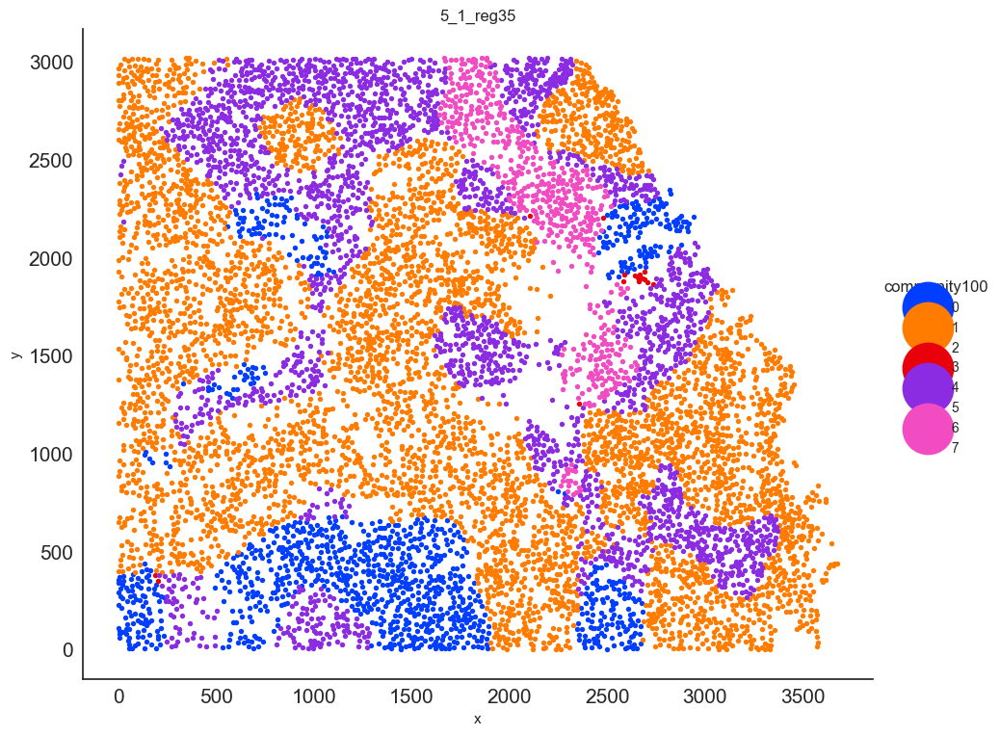

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg36


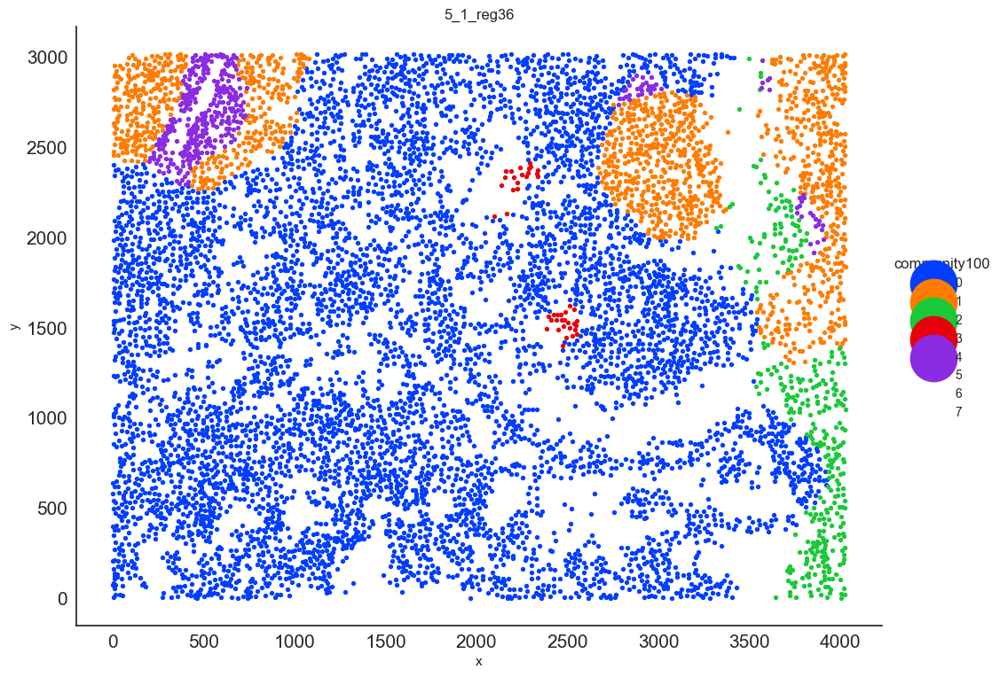

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg37


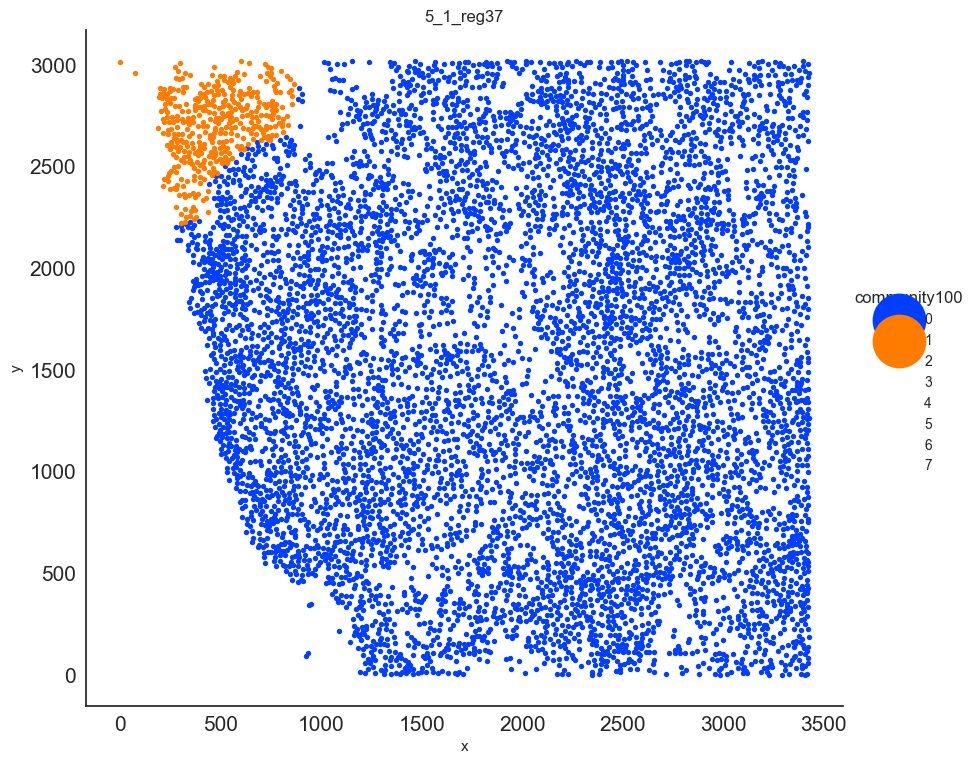

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


1_1_reg39


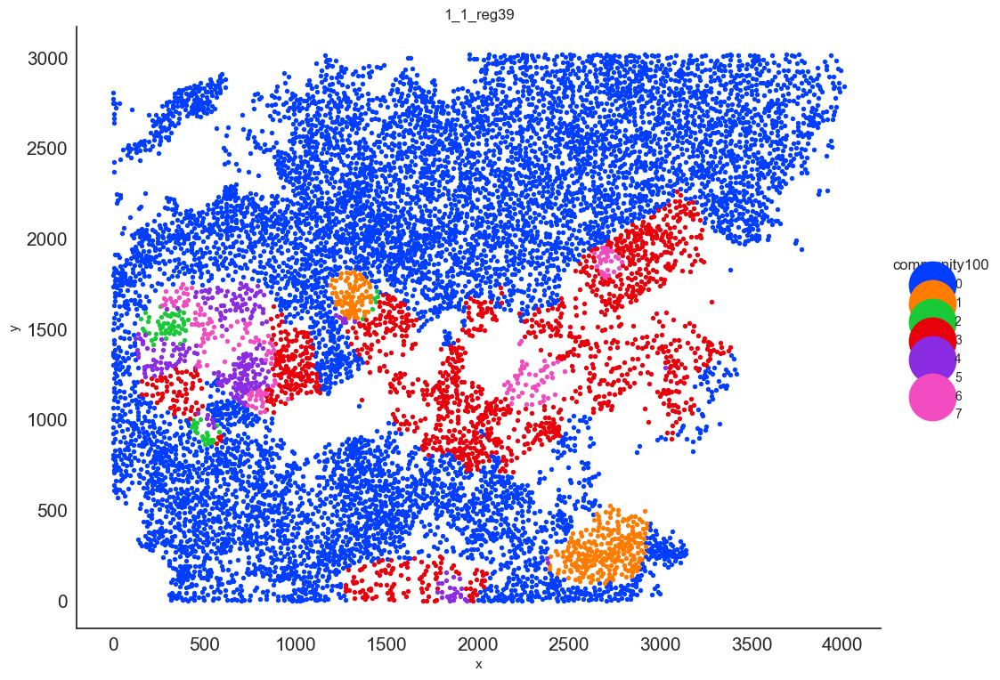

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


3_1_reg46


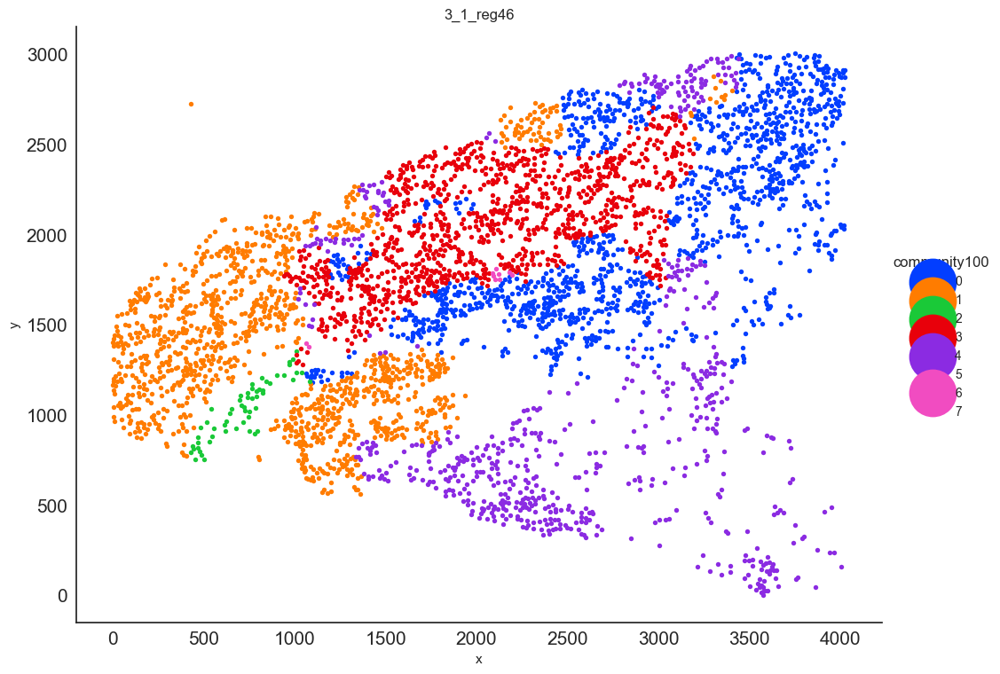

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg49


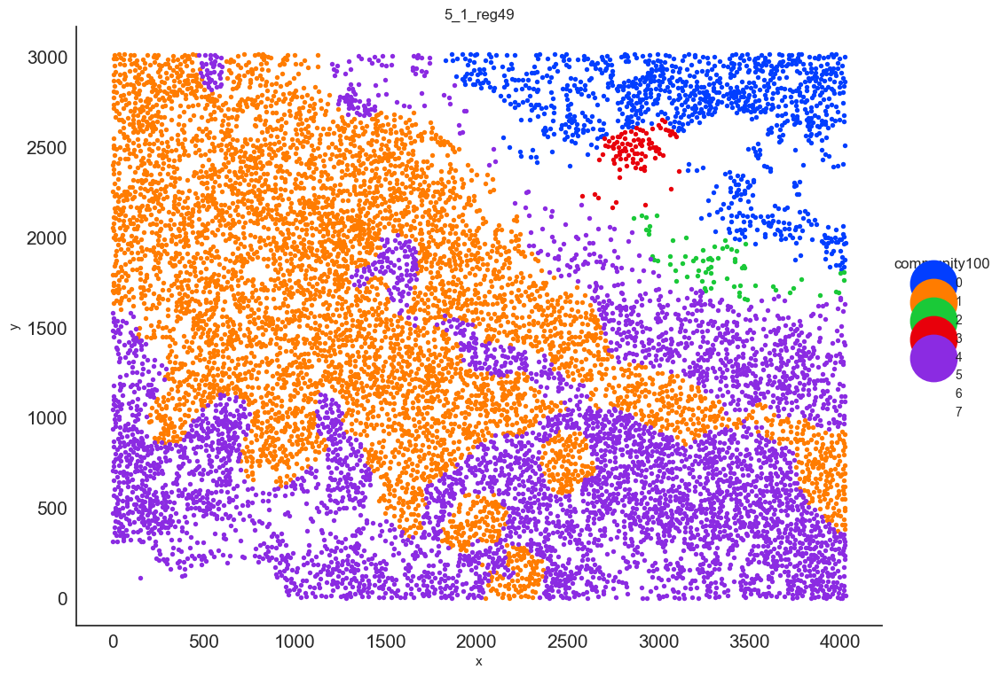

/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2000: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[X]=data[X]-data[X].min()
/Users/timnoahkempchen/Desktop/SAP3/uptodate_work/Functions/Python/SAP_plot_pl.py:2001: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[Y]=data[Y]-data[Y].min()


5_1_reg50


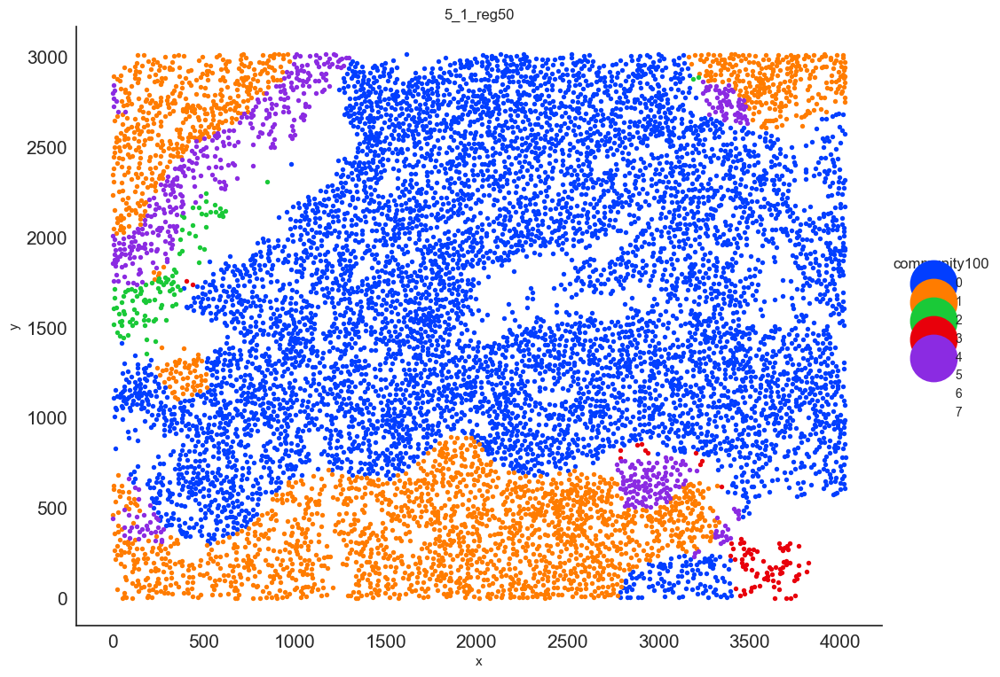

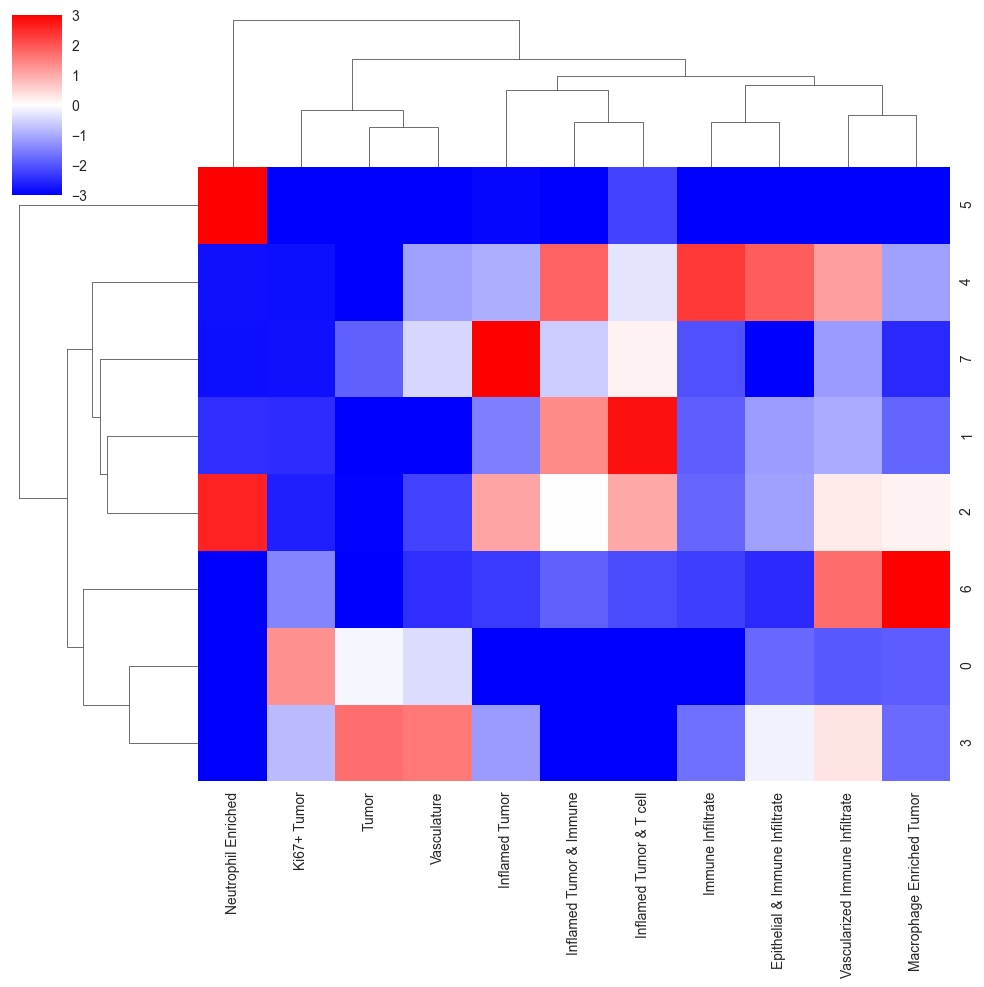

In [36]:
cells_df2, neighborhood_name, k_centroids = tl_community_analysis_2(data = data, 
                        values = values, 
                        sum_cols = sum_cols, 
                        X = X, 
                        Y = Y, 
                        reg = reg, 
                        cluster_col = cluster_col_commun, 
                        k = k_commun, 
                        n_neighborhoods = n_communities_commun,
                        elbow = False)

pl_community_analysis_2(data = cells_df2, 
                        values = values, 
                        sum_cols = sum_cols, 
                        output_dir = output_dir, 
                        X = X, 
                        Y = Y, 
                        reg = reg, 
                        save_path = None, 
                        k = k_commun, 
                        neighborhood_name = neighborhood_name,
                        k_centroids = k_centroids,
                        plot_specific_community = None, 
                        size=60)